In [5]:
from anndata import read_h5ad
import pandas as pd
import numpy as np
import scvi
import scanpy as sc

%load_ext nb_black
use_cuda = True


The nb_black extension is already loaded. To reload it, use:
  %reload_ext nb_black


<IPython.core.display.Javascript object>

In [23]:
import sys
data_path = "../../../TabulaSapiensData/"
ts_path = "../"
sys.path.append(ts_path)


<IPython.core.display.Javascript object>

In [6]:
import matplotlib.pyplot as plt

%matplotlib inline

<IPython.core.display.Javascript object>

In [8]:
adata = read_h5ad(data_path + "decontX/Pilot1_Pilot2.decontX.h5ad")

<IPython.core.display.Javascript object>

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9002. The TBB threading layer is disabled.
  warnings.warn(problem)
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


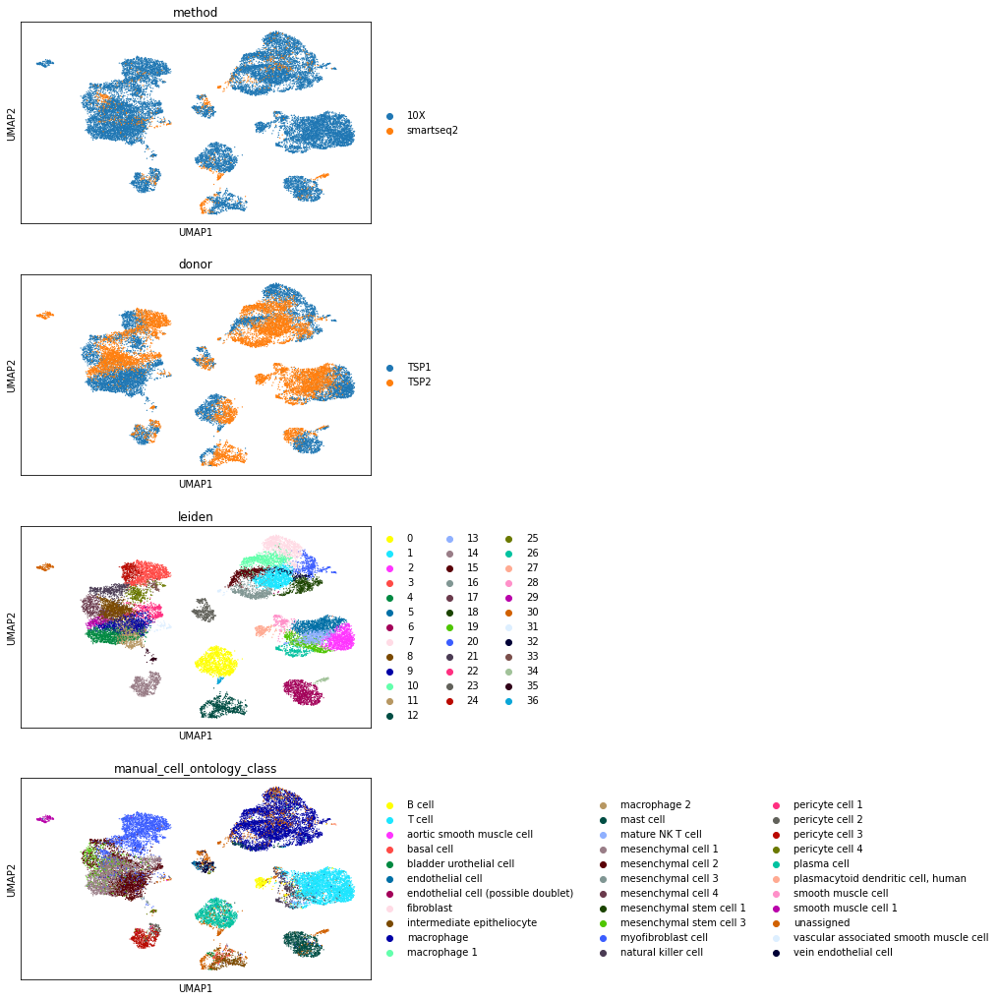

<IPython.core.display.Javascript object>

In [9]:
organ = "Bladder"
organ_adata = adata[adata.obs["tissue"] == organ]
sc.pp.neighbors(organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(organ_adata)
organ_adata.obsm["X_umap_decontX"] = organ_adata.obsm["X_umap"].copy()
sc.tl.leiden(organ_adata, resolution=2)
sc.pl.umap(
    organ_adata,
    color=["method", "donor", "leiden", "manual_cell_ontology_class"],
    ncols=1,
)
organ_adata.X = np.log1p(organ_adata.X)

# cluster to celltype correspondance
count is a matrix of cluster-cell type correspondance, where each row is a celltype, and each colum is a cluster. The entries to the matrix is the number of cells that is annotated as celltype *X* and cluster *Y*

In [10]:
count = {}
for c in np.unique(organ_adata.obs["leiden"]):
    count[c] = {}
    for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
        count[c][t] = np.sum(
            (organ_adata.obs["leiden"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )

count = pd.DataFrame.from_dict(count)

<IPython.core.display.Javascript object>

We can visualize the cluster assignment of each cell type through this heatmap. The color is normalized for each celltype 

<AxesSubplot:>

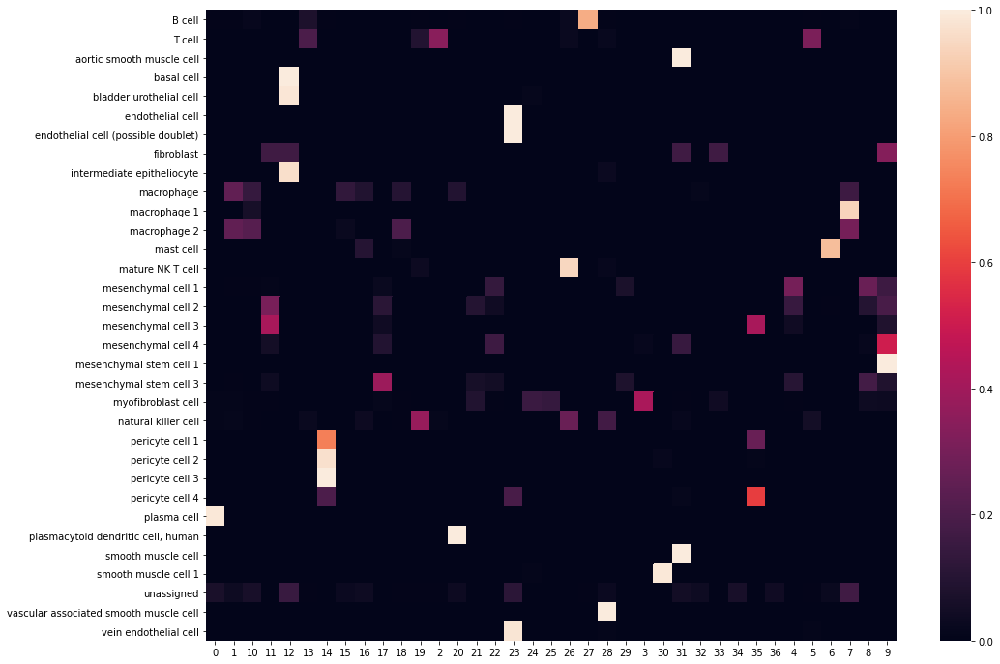

<IPython.core.display.Javascript object>

In [14]:
import seaborn

plt.figure(figsize=(16, 12))
seaborn.heatmap((count.T / count.sum(axis=1)).T)

# dictionary of cell type composition of each cluster 
What are clusters previously annotated as 

In [15]:
cluster_composition = {}
for x in count.columns.values:
    t = count.index[count[x] > 0].values
    freq = np.asarray([count.loc[y, x] for y in t]) / count[x].sum()
    res = [a + ": %.2f" % b for a, b in zip(t, freq)]
    cluster_composition[x] = res

<IPython.core.display.Javascript object>

In [16]:
cluster_composition["0"]

['B cell: 0.00',
 'T cell: 0.00',
 'macrophage: 0.01',
 'mast cell: 0.00',
 'mesenchymal cell 1: 0.00',
 'myofibroblast cell: 0.02',
 'natural killer cell: 0.00',
 'plasma cell: 0.90',
 'unassigned: 0.07']

<IPython.core.display.Javascript object>

# Reassign pure clusters
If a cluster is very pure (>95% of annotated cells come from the same celltype, we reassign the clusters to all have the same labels) 

In [17]:
def Purity(x):
    names = x.index
    x = np.asarray(x).ravel()
    x = x[names != "unassigned"]
    return (np.max(x) / np.sum(x), names[np.argmax(x)])

<IPython.core.display.Javascript object>

In [18]:
cluster_purity = count.apply(Purity, axis=0).T
confident_clusters = cluster_purity[cluster_purity[0] > 0.95].index

<ipython-input-17-963029a66ab7>:5: RuntimeWarning: invalid value encountered in long_scalars
  return (np.max(x) / np.sum(x), names[np.argmax(x)])


<IPython.core.display.Javascript object>

In [19]:
for i in confident_clusters:
    organ_adata.obs.loc[
        organ_adata.obs["leiden"] == i, "new_manual_cell_ontology_class"
    ] = cluster_purity.loc[i, 1]

<IPython.core.display.Javascript object>

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'new_manual_cell_ontology_class' as categorical


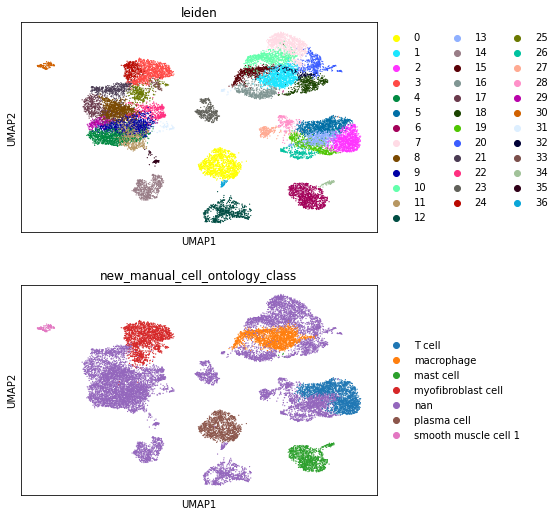

<IPython.core.display.Javascript object>

In [20]:
sc.pl.umap(
    organ_adata,
    color=["leiden", "new_manual_cell_ontology_class"],
    ncols=1,
)

In [37]:
organ_adata.obs.groupby(["leiden"]).agg(
    {"new_manual_cell_ontology_class": set, "Propagated.Annotation": set}
)

,new_manual_cell_ontology_class,Propagated.Annotation
leiden,,
0,{plasma cell},"{B cell, plasma cell}"
1,{macrophage},"{macrophage, macrophage 1, natural killer cell..."
2,{T cell},"{T cell, natural killer cell, mature NK T cell}"
3,{myofibroblast cell},"{myofibroblast cell, mesenchymal cell 4, fibro..."
4,{nan},"{mesenchymal cell 1, mesenchymal cell 4, mesen..."
5,{T cell},"{natural killer cell, mature NK T cell, B cell..."
6,{mast cell},{mast cell}
7,{nan},"{macrophage, macrophage 1, macrophage 2}"
8,{nan},"{myofibroblast cell, mesenchymal cell 1, mesen..."


<IPython.core.display.Javascript object>

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



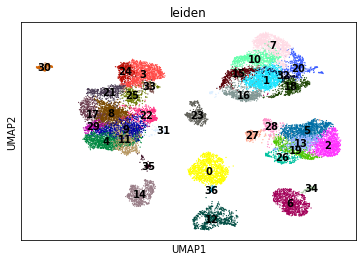

<IPython.core.display.Javascript object>

In [38]:
sc.pl.umap(organ_adata, color="leiden", legend_loc="on data")

# Sankey Diagram between cluster and compartment

In [39]:
from utils.colorDict import (
    donor_colors,
    method_colors,
    compartment_colors,
    tissue_colors,
)

<IPython.core.display.Javascript object>

In [40]:
from utils.plotting_utils import *
from utils.colorDict import compartment_colors

import plotly
import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

import plotly.io as pio

pio.renderers.default = "notebook"

init_notebook_mode(connected=True)

<IPython.core.display.Javascript object>

In [41]:
df = pd.DataFrame(columns=["celltype", "compartment", "count"])
for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
    for c in np.unique(organ_adata.obs["compartment_pred_svm"]):
        x = np.sum(
            (organ_adata.obs["compartment_pred_svm"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )
        df = df.append(
            pd.DataFrame([t, c, x], index=["celltype", "compartment", "count"]).T,
            ignore_index=True,
        )


fig = genSankey(
    df,
    cat_cols_color=[compartment_colors(), "#00A1E0"],
    cat_cols=["compartment", "celltype"],
    value_cols="count",
    title="celltype-compartment",
)
iplot(fig, validate=False)
plotly.offline.plot(
    fig, validate=False, filename="figures/celltype_sankey_%s" % organ + ".html"
)  # , output_type='div')

'figures/celltype_sankey_Bladder.html'

<IPython.core.display.Javascript object>

# visualize compartment markers

In [42]:
compartment_markers = {
    "Epithelial": ["CDH1", "CLDN4", "EPCAM"],
    "Endothelial": ["CA4", "CDH5", "CLDN5", "PECAM1", "VWF"],
    "Stromal": ["BGN", "DCN", "COL1A2"],
    "Immune": ["LCP1", "PTPRC", "RAC2"],
}

<IPython.core.display.Javascript object>

In [43]:
for x in compartment_markers.keys():
    sc.tl.score_genes(organ_adata, compartment_markers[x], score_name="%s_score" % x)

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



<IPython.core.display.Javascript object>

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



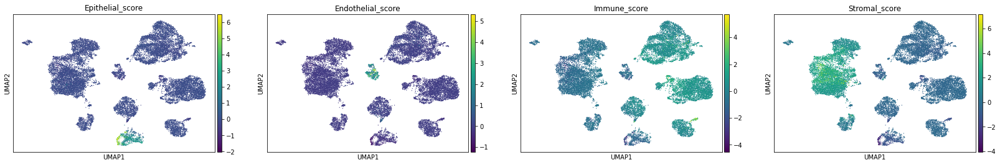

<IPython.core.display.Javascript object>

In [44]:
sc.pl.umap(
    organ_adata,
    color=["Epithelial_score", "Endothelial_score", "Immune_score", "Stromal_score"],
)

# Find markers for each cluster

In [45]:
sc.tl.rank_genes_groups(organ_adata, groupby="leiden", method="wilcoxon")

<IPython.core.display.Javascript object>

In [46]:
def FormatDE(res):
    groups = res['scores'].dtype.names
    df_res = {}
    for group in groups:
        df = pd.DataFrame([res['scores'][group],
                           res['logfoldchanges'][group],res['pvals_adj'][group]], 
                           columns=res['names'][group],
                           index=['wilcoxon_score','log fold change','adjusted pvalue'])
        df_res[group] = df
    return df_res


<IPython.core.display.Javascript object>

In [47]:
DE = FormatDE(organ_adata.uns["rank_genes_groups"])

<IPython.core.display.Javascript object>

### top positive marker genes

In [48]:
organ_cluster_genes = pd.DataFrame(organ_adata.uns['rank_genes_groups']['names'])
organ_cluster_genes.iloc[:20]


,0,1,2,3,4,5,6,7,8,9,...,27,28,29,30,31,32,33,34,35,36
0,MZB1,CD163,CXCR4,PLAT,GSN,IL32,TPSB2,F13A1,GPX3,SFRP2,...,CD79A,STMN1,FBN1,DES,MTRNR2L12,LAPTM5,A2M,TPSB2,SCN7A,DERL3
1,JCHAIN,CTSB,CD3D,PDGFRA,PCOLCE2,CD3D,TPSAB1,FOLR2,FSTL1,MGP,...,HLA-DQA1,CORO1A,MFAP5,SYNM,FTH1P20,CD163,PDGFRA,TPSAB1,CDH19,MZB1
2,DERL3,FCER1G,IL7R,PDPN,CFD,CD2,CPA3,RNASE1,DCN,GSN,...,BANK1,HMGB2,FSTL1,ACTG2,TMSB4XP4,LYZ,HSD17B2,KIT,CRYAB,FKBP11
3,SSR4,FCGR3A,CD3E,F3,IGFBP6,IL7R,HPGDS,STAB1,ADH1B,CCDC80,...,MS4A1,MKI67,PTGIS,CNN1,AL512646.1,FCER1G,PLAT,CPA3,GPM6B,SLAMF7
4,SEC11C,S100A9,CCL5,A2M,PRELP,LTB,RHEX,C1QC,NID1,CFD,...,CD52,RAC2,SCARA5,MYH11,MTRNR2L8,ACTR2,TRPA1,RHEX,S100B,TXNDC5
5,IGHA1,AIF1,IL32,TGM2,CCN5,CXCR4,MS4A2,C1QA,MGP,IGFBP6,...,TNFRSF13C,H2AFV,CCDC80,SMTN,RPL7P1,CTSB,F3,ANXA1,PLP1,HERPUD1
6,IGKC,MARCO,TRAC,ITGA8,FBLN1,CD3E,IL1RL1,SELENOP,ABI3BP,C3,...,HLA-DRA,HMGB1,CD248,MYLK,BX679664.1,SPI1,NR2F1,LMNA,NRXN1,SEC11C
7,FKBP11,TYROBP,CD52,TRPA1,FBLN2,CD52,KIT,C1QB,FBLN5,DCN,...,HLA-DPA1,ANP32B,TGFBR3,SYNPO2,RPL7P9,S100A9,BMP5,VWA5A,CD9,ISG20
8,ISG20,LAPTM5,CD2,TBX3,LTBP4,LEPROTL1,VWA5A,LYVE1,SPOCK1,FBLN1,...,CD37,TMPO,DCLK1,ACTC1,AC090602.1,GNAI2,COL3A1,VIM,LGI4,SSR4
9,IGHA2,CTSZ,CD48,HSD17B2,HTRA1,CYTIP,ALOX5AP,MRC1,COL6A1,C1R,...,IGKC,PTTG1,RAMP2,MYL9,FTH1P8,LCP1,GJA1,IL1RL1,MAL,CYBA


<IPython.core.display.Javascript object>

In [49]:
for x in DE.keys():
    print(x)
    display(DE[x].T[:20])

0


,wilcoxon_score,log fold change,adjusted pvalue
MZB1,54.887875,9.210375,0.0
JCHAIN,54.653519,13.455458,0.0
DERL3,53.610046,8.177074,0.0
SSR4,53.125519,4.410835,0.0
SEC11C,53.047897,5.036105,0.0
IGHA1,52.321701,10.725486,0.0
IGKC,51.730370,13.107968,0.0
FKBP11,49.783272,4.404583,0.0
ISG20,49.384445,4.098449,0.0
IGHA2,46.502285,11.038284,0.0


1


,wilcoxon_score,log fold change,adjusted pvalue
CD163,50.877266,5.220725,0.0
CTSB,48.848820,4.016105,0.0
FCER1G,48.323311,4.295830,0.0
FCGR3A,47.900600,4.615823,0.0
S100A9,46.722664,5.167585,0.0
AIF1,46.538826,4.171305,0.0
MARCO,45.877159,5.036782,0.0
TYROBP,45.060795,3.696528,0.0
LAPTM5,45.015511,3.194157,0.0
CTSZ,44.932167,3.116757,0.0


2


,wilcoxon_score,log fold change,adjusted pvalue
CXCR4,43.515156,3.536783,0.000000e+00
CD3D,42.946651,3.497377,0.000000e+00
IL7R,39.929932,3.483203,0.000000e+00
CD3E,39.889977,3.279393,0.000000e+00
CCL5,39.428661,4.445378,0.000000e+00
IL32,38.500389,2.891577,0.000000e+00
TRAC,38.426304,2.993818,0.000000e+00
CD52,37.763039,2.745513,0.000000e+00
CD2,37.699829,2.997967,0.000000e+00
CD48,36.585335,2.462223,1.309381e-289


3


,wilcoxon_score,log fold change,adjusted pvalue
PLAT,44.640926,4.362408,0.000000e+00
PDGFRA,44.586697,4.272672,0.000000e+00
PDPN,43.660000,3.982738,0.000000e+00
F3,43.314838,4.515999,0.000000e+00
A2M,42.202045,4.265501,0.000000e+00
TGM2,41.718872,4.454392,0.000000e+00
ITGA8,40.959431,4.847986,0.000000e+00
TRPA1,40.593281,6.056563,0.000000e+00
TBX3,40.375965,3.921355,0.000000e+00
HSD17B2,40.269047,4.737342,0.000000e+00


4


,wilcoxon_score,log fold change,adjusted pvalue
GSN,46.468998,5.007338,0.0
PCOLCE2,46.255943,4.806362,0.0
CFD,45.692726,5.858533,0.0
IGFBP6,43.536926,4.798493,0.0
PRELP,41.912491,3.503680,0.0
CCN5,41.256042,4.076720,0.0
FBLN1,41.163933,4.613425,0.0
FBLN2,41.064129,3.448414,0.0
LTBP4,40.825932,3.147819,0.0
HTRA1,40.756477,3.117294,0.0


5


,wilcoxon_score,log fold change,adjusted pvalue
IL32,42.647728,3.701992,0.000000e+00
CD3D,41.216057,3.652425,0.000000e+00
CD2,39.944164,3.683558,0.000000e+00
IL7R,39.836521,3.894154,0.000000e+00
LTB,39.333294,4.445097,0.000000e+00
CXCR4,37.480728,3.040606,1.396702e-303
CD3E,36.519131,3.198894,3.245211e-288
CD52,36.250248,3.036601,5.270516e-284
LEPROTL1,35.312626,2.409321,1.702243e-269
CYTIP,33.613251,2.445712,3.328495e-244


6


,wilcoxon_score,log fold change,adjusted pvalue
TPSB2,51.129158,9.728755,0.000000e+00
TPSAB1,51.127464,9.307931,0.000000e+00
CPA3,49.593483,7.928069,0.000000e+00
HPGDS,47.717525,6.619493,0.000000e+00
RHEX,44.130657,6.257643,0.000000e+00
MS4A2,43.459045,6.732122,0.000000e+00
IL1RL1,42.330887,6.221431,0.000000e+00
KIT,40.651794,5.872243,0.000000e+00
VWA5A,39.480240,4.053689,0.000000e+00
ALOX5AP,38.957569,2.991794,0.000000e+00


7


,wilcoxon_score,log fold change,adjusted pvalue
F13A1,45.929726,4.968586,0.000000e+00
FOLR2,45.818150,4.940520,0.000000e+00
RNASE1,45.386265,5.549623,0.000000e+00
STAB1,45.039536,4.249252,0.000000e+00
C1QC,44.843655,4.698154,0.000000e+00
C1QA,44.607414,5.167212,0.000000e+00
SELENOP,44.226860,3.805764,0.000000e+00
C1QB,43.749752,4.912024,0.000000e+00
LYVE1,43.640488,5.234133,0.000000e+00
MRC1,43.178169,4.165685,0.000000e+00


8


,wilcoxon_score,log fold change,adjusted pvalue
GPX3,45.554199,5.029765,0.0
FSTL1,44.883896,4.659216,0.0
DCN,44.405445,6.071590,0.0
ADH1B,43.859451,4.661516,0.0
NID1,43.656231,4.357845,0.0
MGP,43.563004,6.000930,0.0
ABI3BP,43.434788,4.267240,0.0
FBLN5,43.027332,4.013848,0.0
SPOCK1,42.883602,4.903323,0.0
COL6A1,42.585674,3.936626,0.0


9


,wilcoxon_score,log fold change,adjusted pvalue
SFRP2,39.820980,4.751153,0.000000e+00
MGP,38.334354,5.373770,0.000000e+00
GSN,37.725578,4.405210,0.000000e+00
CCDC80,37.358681,3.863140,2.697459e-301
CFD,37.216183,5.221563,4.398503e-299
IGFBP6,37.056808,4.386513,1.368934e-296
C3,36.277317,3.938239,3.101100e-284
DCN,35.976601,5.505289,1.429839e-279
FBLN1,35.865177,4.681441,6.977948e-278
C1R,35.645061,4.081071,1.654309e-274


10


,wilcoxon_score,log fold change,adjusted pvalue
RNASE1,38.000034,5.263969,0.000000e+00
MS4A6A,37.733391,4.189785,0.000000e+00
CD163,37.530052,4.519565,5.849392e-304
LYZ,35.106880,3.985788,7.790870e-266
VSIG4,34.920597,3.876204,4.262359e-263
MS4A7,34.703457,3.682238,6.854988e-260
F13A1,34.643898,3.930148,4.641958e-259
TYROBP,34.636654,3.736762,5.221058e-259
C5AR1,34.560307,3.766005,6.528018e-258
MRC1,33.777866,3.630911,2.454366e-246


11


,wilcoxon_score,log fold change,adjusted pvalue
MGP,35.541351,5.221568,6.653064e-272
SFRP2,35.191223,4.015610,8.018265e-267
DPT,34.552605,3.758980,2.556277e-257
GSN,33.341511,3.870406,1.423262e-239
APOD,32.897942,4.287737,2.769218e-233
CXCL12,32.705219,2.947032,1.291742e-230
SOCS3,32.436047,2.628996,7.166718e-227
GEM,32.390022,2.943297,2.791338e-226
FBLN1,32.383121,4.134398,3.103138e-226
RARRES2,32.110832,3.057521,1.832566e-222


12


,wilcoxon_score,log fold change,adjusted pvalue
S100P,44.743073,10.488439,0.0
KRT19,44.526695,11.283803,0.0
TACSTD2,44.322414,9.624561,0.0
CLDN4,44.272713,10.134452,0.0
GPX2,44.236710,11.860182,0.0
ELF3,44.235207,11.479672,0.0
PSCA,43.910175,10.988228,0.0
AGR2,43.371098,11.175596,0.0
KRT8,42.736664,9.212081,0.0
CSTB,42.618549,5.401381,0.0


13


,wilcoxon_score,log fold change,adjusted pvalue
IL7R,37.456848,4.648630,2.735540e-302
CXCR4,30.001825,2.959789,7.812773e-194
CD2,28.908054,3.009040,4.639330e-180
CD69,28.317842,2.831081,8.763646e-173
CD3E,26.894445,2.860744,7.507651e-156
CD3D,26.870216,2.673789,1.310304e-155
PTPRC,25.690207,2.108582,3.279170e-142
PPP2R5C,24.658985,1.803386,5.258642e-131
ETS1,24.580303,2.233547,3.451278e-130
GPR171,24.096214,3.705303,3.430571e-125


14


,wilcoxon_score,log fold change,adjusted pvalue
TAGLN,40.453667,8.160821,0.000000e+00
ACTA2,40.435066,7.642255,0.000000e+00
MYL9,40.245964,6.000098,0.000000e+00
TPM2,39.014664,6.073822,0.000000e+00
AP002956.1,37.299347,6.792750,1.980006e-300
C11orf96,36.766830,5.104888,6.141595e-292
NOTCH3,36.641056,6.839664,5.342448e-290
TPM1,36.382668,4.441488,5.888783e-286
PPP1R14A,36.317200,6.219965,5.664722e-285
MYH11,36.016052,6.963906,2.761709e-280


15


,wilcoxon_score,log fold change,adjusted pvalue
EREG,36.837868,6.188305,2.693052e-292
IL1B,36.631912,6.240487,2.614475e-289
C5AR1,35.018970,4.283559,2.271096e-264
AIF1,34.592972,4.379694,4.742803e-258
LST1,34.329693,3.958699,3.332275e-254
FCN1,34.252686,5.346141,3.902635e-253
PLAUR,34.177616,4.059762,4.374024e-252
S100A9,33.794445,5.296476,1.751234e-246
TNFRSF1B,33.620617,3.430300,5.483905e-244
BCL2A1,33.520676,4.074143,1.418160e-242


16


,wilcoxon_score,log fold change,adjusted pvalue
S100A8,37.015385,7.059103,3.813035e-295
S100A9,36.710575,7.015383,1.457727e-290
LYZ,34.767914,5.235837,1.458460e-260
VCAN,34.069016,4.250918,3.124189e-250
GCA,32.210606,3.746130,1.476326e-223
FPR1,31.991871,4.014740,1.388068e-220
S100A12,31.857924,6.481596,8.598773e-219
ACSL1,31.694576,3.749532,1.358000e-216
CD163,30.685968,3.853070,5.729675e-203
BCL2A1,30.500786,3.756506,1.497704e-200


17


,wilcoxon_score,log fold change,adjusted pvalue
IGFBP4,34.375977,4.932137,2.166107e-254
PLA2G2A,34.368877,7.648870,2.166107e-254
EFEMP1,33.031075,4.684874,5.708290e-235
RARRES1,32.829754,5.967257,3.261116e-232
PCOLCE,32.551670,4.219103,2.334630e-228
PLAC9,32.485123,3.936192,1.697189e-227
NNMT,32.308895,4.553819,4.412024e-225
COL6A2,32.200294,4.106006,1.286493e-223
C1R,32.081490,4.489032,5.226137e-222
COL1A2,32.055477,4.678870,1.084094e-221


18


,wilcoxon_score,log fold change,adjusted pvalue
AIF1,28.756140,3.758936,4.468392e-177
CXCR4,28.130575,3.286074,1.219285e-169
PTPRC,27.889439,2.855670,7.032108e-167
FYB1,27.757084,2.967520,2.106225e-165
TYROBP,27.732220,3.329965,3.361874e-165
LAPTM5,27.635248,2.815958,4.119081e-164
SRGN,27.616673,3.312053,5.902074e-164
LCP1,27.435867,2.797385,7.538606e-162
GPR183,27.297415,3.368452,2.977665e-160
C5AR1,27.233484,3.410157,1.535161e-159


19


,wilcoxon_score,log fold change,adjusted pvalue
CCL5,31.385399,4.727066,1.884699e-211
GZMA,30.827566,5.195243,3.295833e-204
NKG7,28.860613,4.328840,5.487936e-179
IL32,28.723726,3.448209,2.271128e-177
CD3D,28.523281,3.418081,5.280948e-175
CST7,28.521843,3.601711,5.280948e-175
CXCR4,26.601343,3.125780,3.212985e-152
GZMK,26.266207,5.658832,2.113636e-148
PTPRC,25.296265,2.498648,1.378085e-137
CD2,25.176609,3.141876,2.659112e-136


20


,wilcoxon_score,log fold change,adjusted pvalue
HLA-DPA1,35.373745,7.157074,2.547195e-269
HLA-DRA,35.078960,6.946225,4.153974e-265
HLA-DPB1,35.041794,6.988613,1.020316e-264
HLA-DMA,33.797646,5.004011,3.143390e-246
CD74,33.763905,5.851642,7.868536e-246
HLA-DRB1,33.364632,6.187829,4.385444e-240
HLA-DQB1,33.090969,6.432682,3.371095e-236
HLA-DMB,31.064293,4.664741,5.383363e-208
GPR183,31.026201,4.723344,1.563182e-207
CD83,30.381006,4.291853,5.763120e-199


21


,wilcoxon_score,log fold change,adjusted pvalue
PDPN,32.962826,4.864264,1.631210e-233
LUM,32.567184,5.492128,3.520264e-228
SOD3,32.350018,4.940713,2.720927e-225
CFH,32.016399,4.657860,9.489899e-221
TMEM176A,31.968000,4.687727,3.576256e-220
RARRES2,31.926622,4.393816,1.119243e-219
FGF7,31.320404,4.463663,2.070322e-211
TMEM176B,31.052200,4.356524,7.840075e-208
COL3A1,30.489014,4.872524,2.222283e-200
HSPB6,30.487860,3.941231,2.222283e-200


22


,wilcoxon_score,log fold change,adjusted pvalue
ADH1B,24.478828,3.459144,3.654254e-128
MGP,23.730284,4.438475,2.067561e-120
IGFBP6,23.603733,3.599464,3.462130e-119
OGN,23.423130,3.122471,1.828089e-117
DCN,22.946707,4.712012,8.506158e-113
CCDC80,22.336634,2.921625,6.848519e-107
GPX3,21.971140,2.693227,2.001091e-103
SFRP2,21.812077,3.074039,6.171035e-102
COL1A2,21.754347,3.069165,2.055038e-101
FBLN5,21.234730,2.400959,1.167973e-96


23


,wilcoxon_score,log fold change,adjusted pvalue
CLDN5,31.009144,14.442230,2.389379e-206
ECSCR,30.802565,11.196363,7.126885e-204
TM4SF1,30.741425,7.786681,3.124210e-203
PECAM1,30.530998,6.862935,1.487804e-200
GNG11,30.473856,5.228800,6.814159e-200
EMCN,29.192068,12.594383,2.399193e-183
VWF,28.835989,12.380898,5.839460e-179
PCAT19,28.834465,11.052166,5.839460e-179
CRIP2,28.652002,5.908466,9.900324e-177
LDB2,28.064072,6.405403,1.583690e-169


24


,wilcoxon_score,log fold change,adjusted pvalue
PITX1,27.768242,4.430728,6.178012e-165
PLAT,26.506403,3.898418,2.407039e-150
HSD17B2,26.187630,4.212796,7.213734e-147
A2M,25.896544,3.897015,1.072094e-143
LTBP4,25.346302,3.097095,1.162202e-137
NBL1,24.898594,2.949365,7.560402e-133
TCF21,24.798811,3.495114,7.765417e-132
MFAP4,24.619917,3.315095,5.689046e-130
CPE,24.398853,3.664784,1.150421e-127
SLC9A3R2,24.370178,3.617668,2.085906e-127


25


,wilcoxon_score,log fold change,adjusted pvalue
MATN2,23.502489,3.602654,2.264527e-117
CFH,23.277748,3.500985,2.193101e-115
NR2F1,23.003723,3.352634,8.394735e-113
SOD3,22.944750,3.534256,2.446819e-112
LUM,22.426722,3.875686,2.542893e-107
FBLN1,22.387907,4.142375,5.065356e-107
TCF21,21.831745,3.303966,9.748209e-102
MEG3,21.443775,3.322936,3.841483e-98
CCN1,20.867548,3.045593,6.908296e-93
RARRES2,20.615982,2.901316,1.161396e-90


26


,wilcoxon_score,log fold change,adjusted pvalue
NKG7,20.938488,4.971535,4.688403e-93
GNLY,20.902159,7.560381,7.531920e-93
KLRD1,20.218616,5.452703,4.940728e-87
PRF1,20.021490,5.306288,2.340824e-85
CTSW,19.079596,3.679701,1.642950e-77
GZMA,18.519110,4.303805,4.059604e-73
GZMB,17.719809,4.880184,5.600606e-67
HOPX,16.945688,3.280287,3.047899e-61
PLAC8,16.361849,3.332076,3.634659e-57
HCST,15.813051,2.161889,2.127004e-53


27


,wilcoxon_score,log fold change,adjusted pvalue
CD79A,21.448463,4.883188,2.778548e-97
HLA-DQA1,21.259195,5.242539,7.977521e-96
BANK1,20.636240,6.474211,2.326747e-90
MS4A1,20.626694,8.345386,2.326747e-90
CD52,20.433260,3.547071,8.306133e-89
TNFRSF13C,20.003534,6.225615,3.775383e-85
HLA-DRA,19.452404,3.615232,1.637102e-80
HLA-DPA1,18.808161,2.954955,3.176270e-75
CD37,18.425186,2.676286,3.238063e-72
IGKC,18.231052,3.217322,1.013396e-70


28


,wilcoxon_score,log fold change,adjusted pvalue
STMN1,23.026390,5.786360,1.493288e-112
CORO1A,22.845427,5.283865,4.776401e-111
HMGB2,22.703976,5.165204,8.031139e-110
MKI67,22.425066,7.961522,3.299187e-107
RAC2,21.708607,4.481215,2.003233e-100
H2AFV,21.571833,3.680465,3.241213e-99
HMGB1,21.463366,3.680128,2.881092e-98
ANP32B,21.366144,3.872318,2.031058e-97
TMPO,21.340042,4.985137,2.970443e-97
PTTG1,21.337952,5.436603,2.970443e-97


29


,wilcoxon_score,log fold change,adjusted pvalue
FBN1,22.285791,5.798136,2.064711e-105
MFAP5,22.271296,6.515242,2.064711e-105
FSTL1,22.193874,5.763035,7.723321e-105
PTGIS,21.691013,4.644562,3.670941e-100
SCARA5,21.543156,4.672459,7.226696e-99
CCDC80,21.428507,5.377238,7.110322e-98
CD248,21.276423,4.704214,1.578835e-96
TGFBR3,21.128283,4.109569,3.216972e-95
DCLK1,21.098915,4.786909,5.323380e-95
RAMP2,20.938915,4.738190,1.393967e-93


30


,wilcoxon_score,log fold change,adjusted pvalue
DES,18.960583,11.148905,1.495530e-75
SYNM,18.929268,8.644739,1.495530e-75
ACTG2,18.921259,10.297977,1.495530e-75
CNN1,18.877699,8.394173,2.159870e-75
MYH11,18.870090,9.162107,2.159870e-75
SMTN,18.865273,7.412912,2.159870e-75
MYLK,18.856369,7.936741,2.190881e-75
SYNPO2,18.841551,7.511200,2.536709e-75
ACTC1,18.815193,11.550217,3.708936e-75
MYL9,18.768690,7.334234,8.018198e-75


31


,wilcoxon_score,log fold change,adjusted pvalue
MTRNR2L12,6.006666,3.483864,7.986136e-08
FTH1P20,5.780329,3.247094,2.937781e-07
TMSB4XP4,4.643824,3.295753,8.940814e-05
AL512646.1,4.240414,3.084024,5.092820e-04
MTRNR2L8,4.223723,3.496972,5.451406e-04
RPL7P1,4.215219,3.628126,5.643562e-04
BX679664.1,4.177338,4.089982,6.564520e-04
RPL7P9,4.173316,3.477555,6.666414e-04
AC090602.1,4.099627,4.262362,8.956378e-04
FTH1P8,4.087305,2.850613,9.393675e-04


32


,wilcoxon_score,log fold change,adjusted pvalue
LAPTM5,15.704559,5.879073,8.286136e-51
CD163,15.587008,6.668911,2.626049e-50
LYZ,15.448133,6.610855,1.433746e-49
FCER1G,15.433515,6.531811,1.433746e-49
ACTR2,15.324457,4.394729,6.180304e-49
CTSB,15.242306,6.034901,1.817276e-48
SPI1,15.164402,4.650106,5.117546e-48
S100A9,15.059796,6.793135,2.190716e-47
GNAI2,15.003118,4.226518,4.582053e-47
LCP1,14.973247,4.813471,6.465433e-47


33


,wilcoxon_score,log fold change,adjusted pvalue
A2M,13.028056,3.675867,2.494291e-34
PDGFRA,12.407500,3.528568,4.669699e-31
HSD17B2,12.159954,3.610795,5.979694e-30
PLAT,12.108190,3.338453,9.377995e-30
TRPA1,11.976130,4.349079,3.487551e-29
F3,11.676556,3.512660,9.888111e-28
NR2F1,11.343753,2.827165,3.907682e-26
BMP5,11.148975,3.989935,3.045916e-25
COL3A1,11.037436,2.900756,9.895149e-25
GJA1,10.637932,2.785708,6.491615e-23


34


,wilcoxon_score,log fold change,adjusted pvalue
TPSB2,14.762918,15.448147,3.947774e-45
TPSAB1,14.761944,15.795559,3.947774e-45
KIT,14.750981,12.223969,3.947774e-45
CPA3,14.748225,13.685553,3.947774e-45
RHEX,14.744195,13.876104,3.947774e-45
ANXA1,14.613371,10.011435,2.264621e-44
LMNA,14.554062,9.844800,4.628487e-44
VWA5A,14.517621,11.552696,6.895615e-44
VIM,14.477170,6.939249,1.022948e-43
IL1RL1,14.475222,11.246401,1.022948e-43


35


,wilcoxon_score,log fold change,adjusted pvalue
SCN7A,10.811492,6.581210,2.689593e-23
CDH19,10.794488,10.787422,2.689593e-23
CRYAB,10.354924,4.920184,1.194779e-21
GPM6B,9.876740,6.645826,8.832850e-20
S100B,9.714261,6.797662,3.674380e-19
PLP1,9.704924,9.872384,3.843836e-19
NRXN1,9.647106,7.936424,6.201297e-19
CD9,9.485092,2.812119,2.545800e-18
LGI4,9.306096,6.139855,1.201103e-17
MAL,8.714974,5.347991,2.062742e-15


36


,wilcoxon_score,log fold change,adjusted pvalue
DERL3,11.969694,12.386723,4.067461e-29
MZB1,11.968685,13.980552,4.067461e-29
FKBP11,11.957243,10.893154,4.067461e-29
SLAMF7,11.953859,11.346677,4.067461e-29
TXNDC5,11.953502,10.784990,4.067461e-29
HERPUD1,11.951267,11.257455,4.067461e-29
SEC11C,11.951063,11.196803,4.067461e-29
ISG20,11.944077,9.186580,4.067461e-29
SSR4,11.942980,9.774405,4.067461e-29
CYBA,11.937003,7.898530,4.067461e-29


<IPython.core.display.Javascript object>

### for cluster 0 plot the top marker genes

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



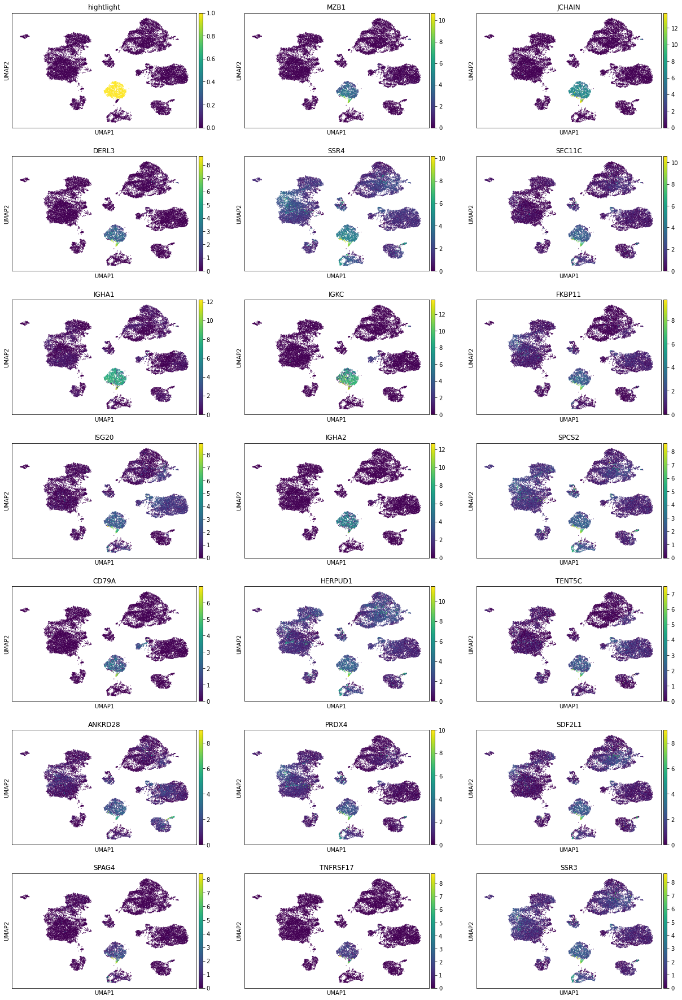

<IPython.core.display.Javascript object>

In [54]:
topgenes = list(DE["0"].T[:20].index)
organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == "0"
sc.pl.umap(
    organ_adata,
    color=["hightlight"] + topgenes,
    ncols=3,
)

You can do this for other clusters as well. Here I plot the top 5 genes for all other clusters

0


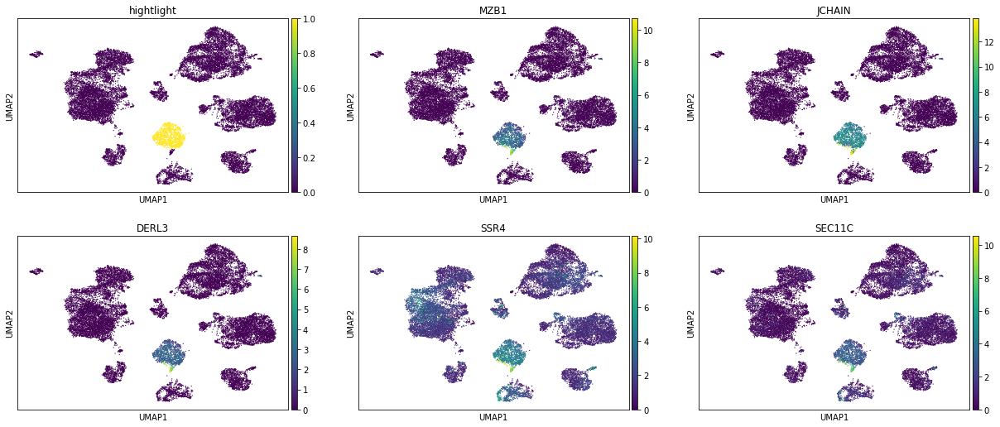

1


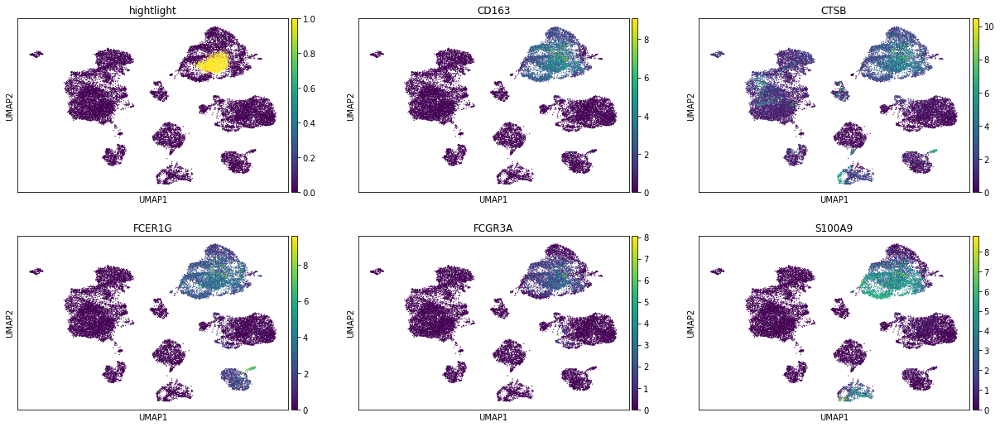

2


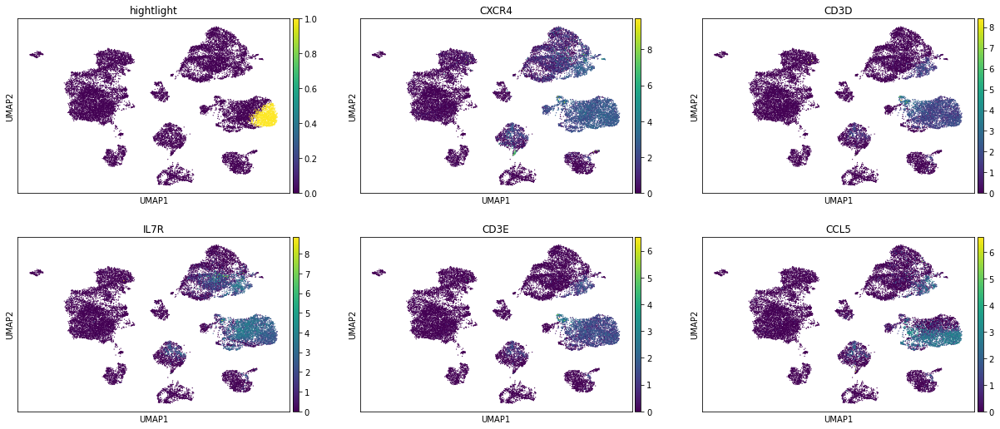

3


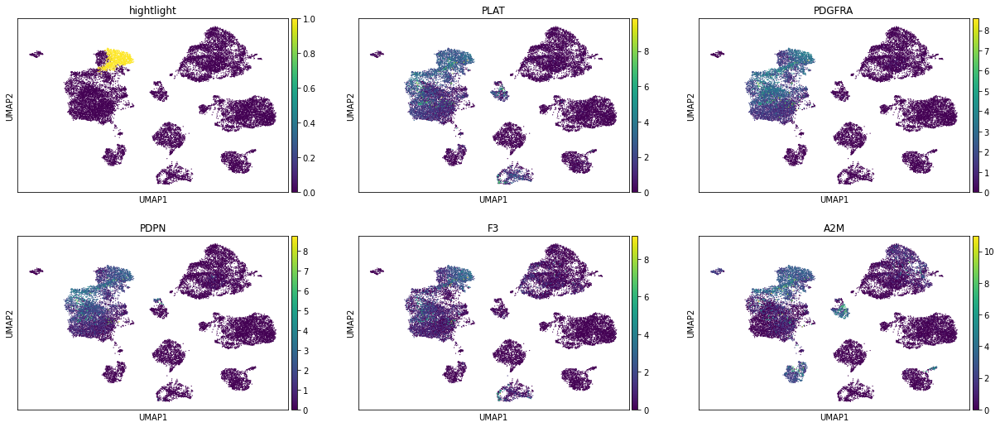

4


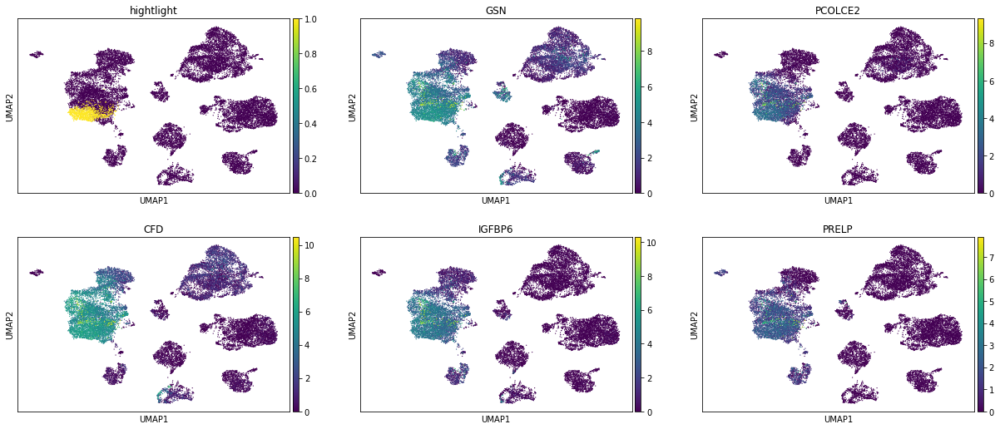

5


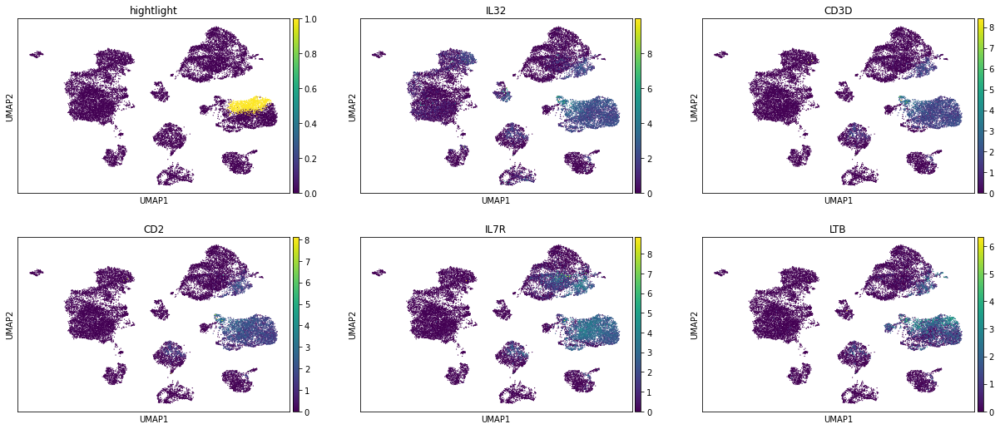

6


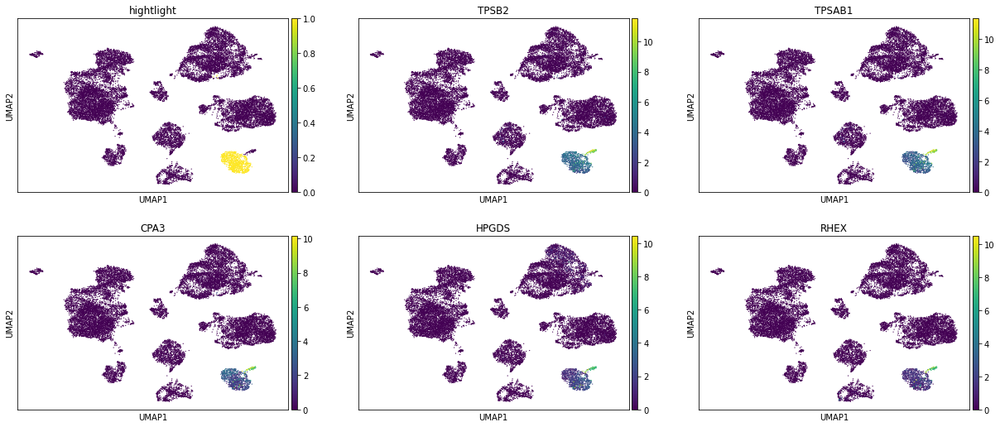

7


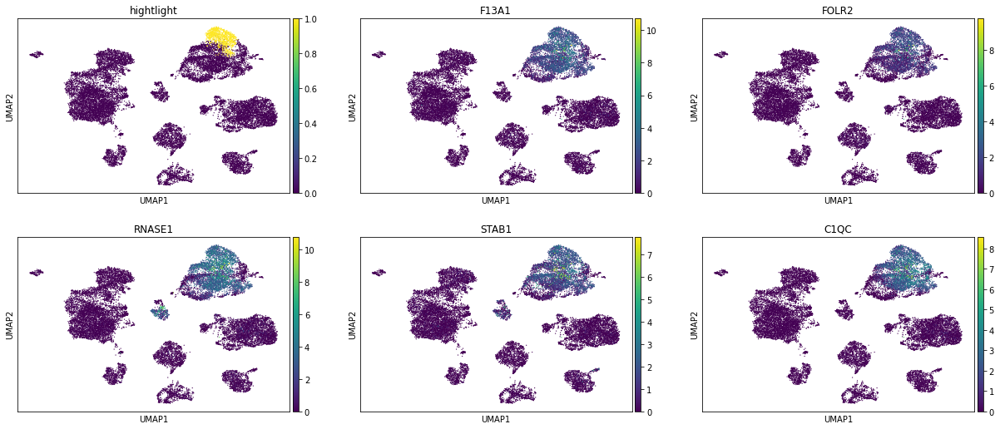

8


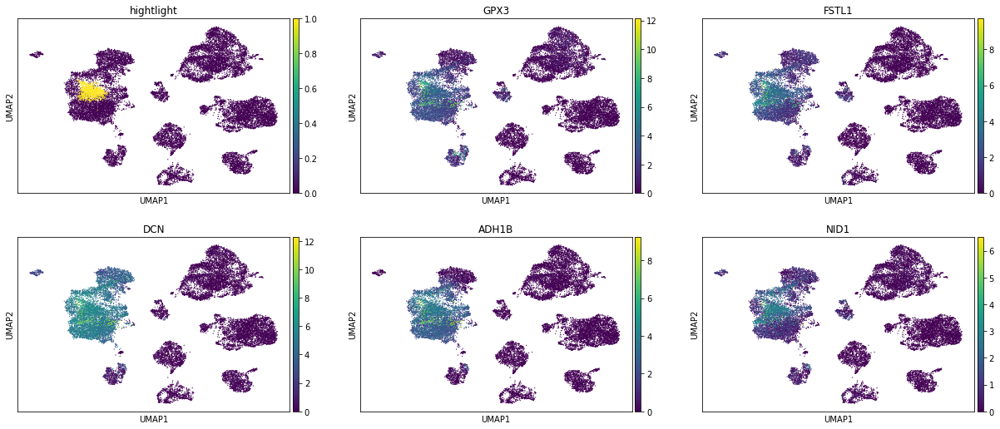

9


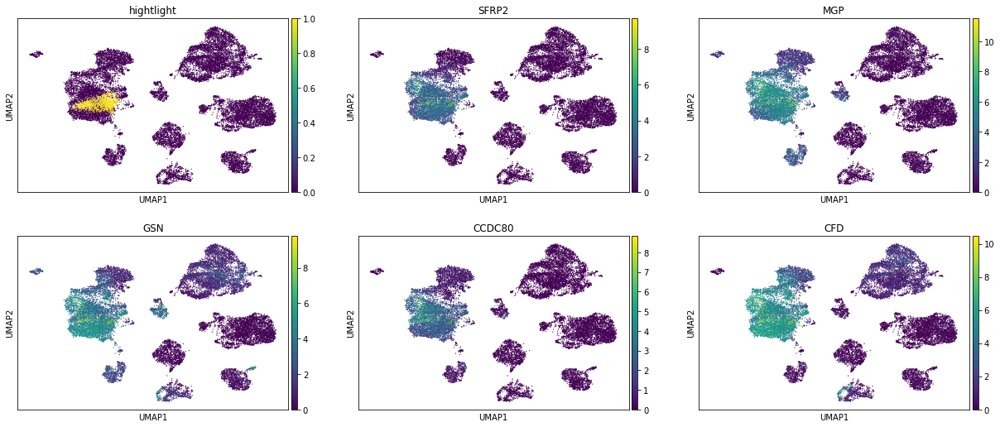

10


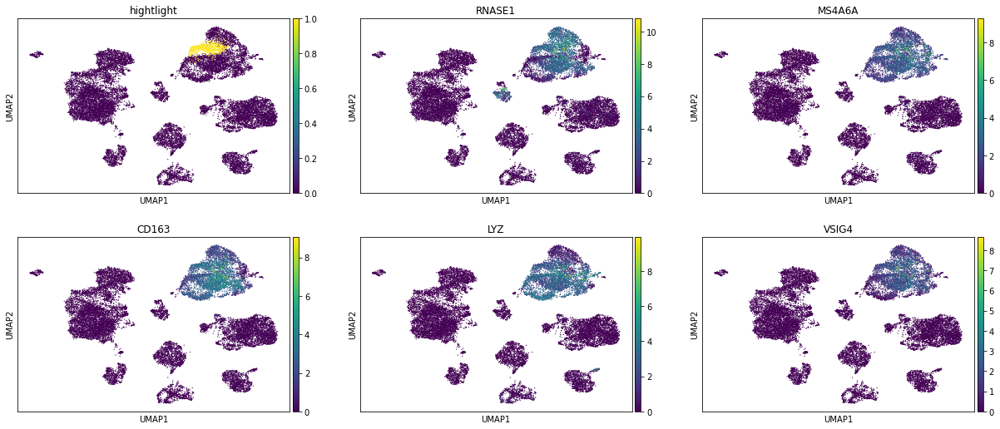

11


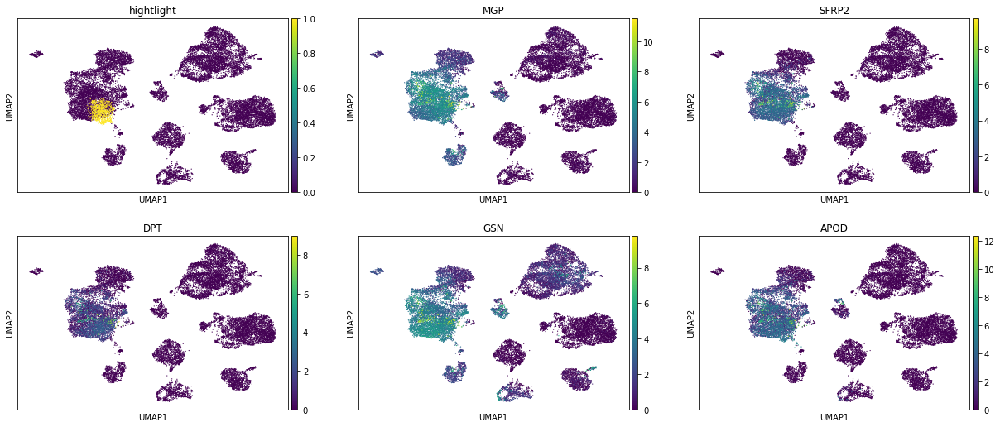

12


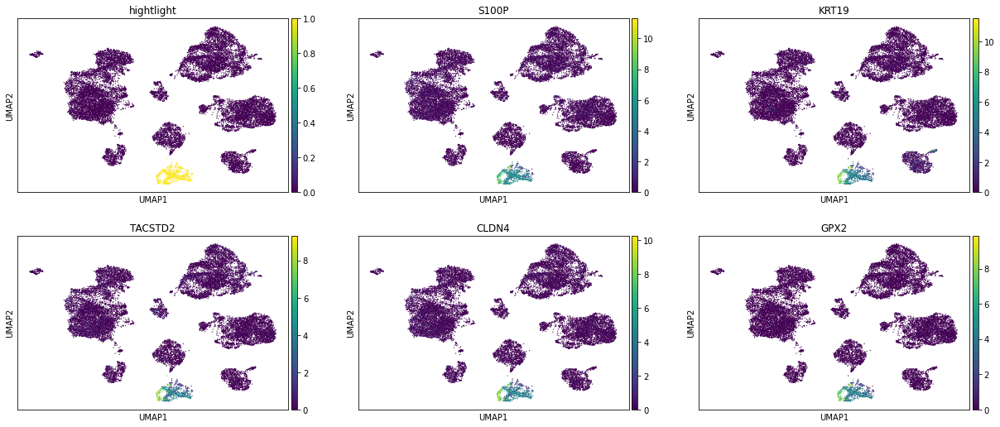

13


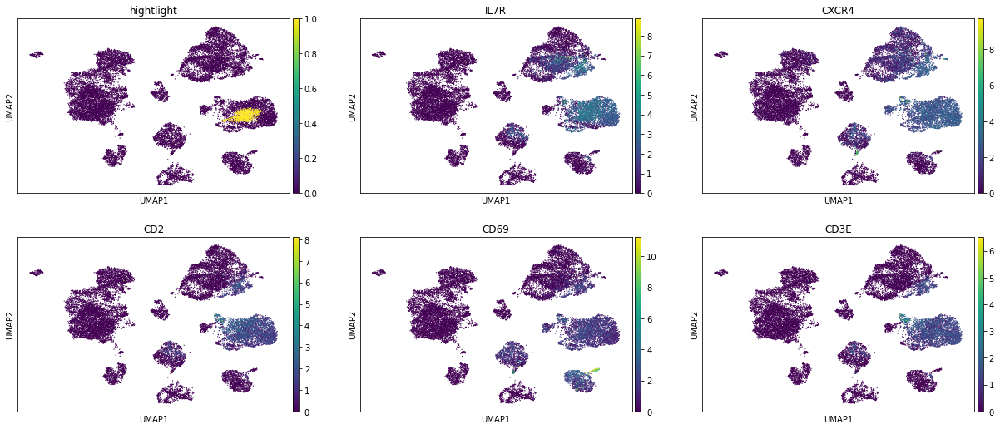

14


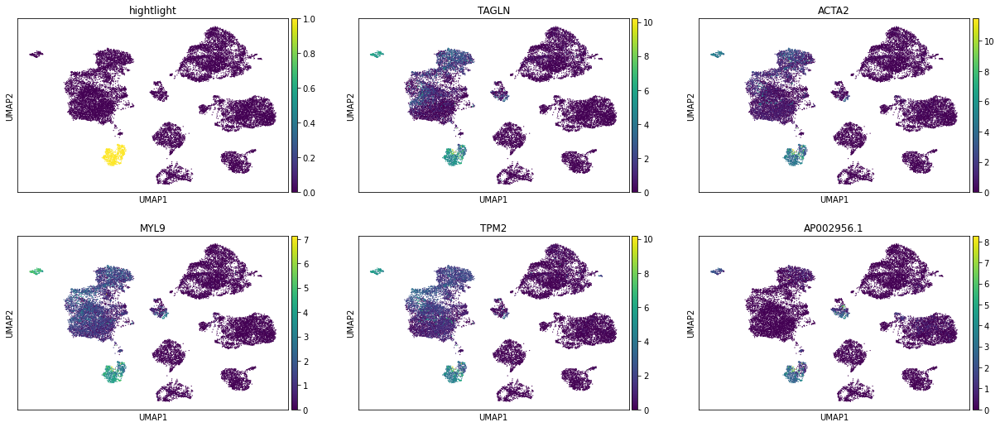

15


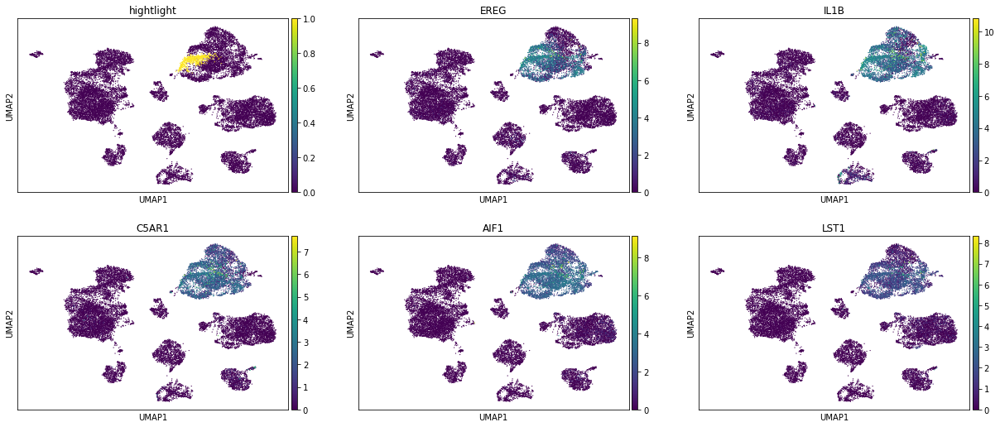

16


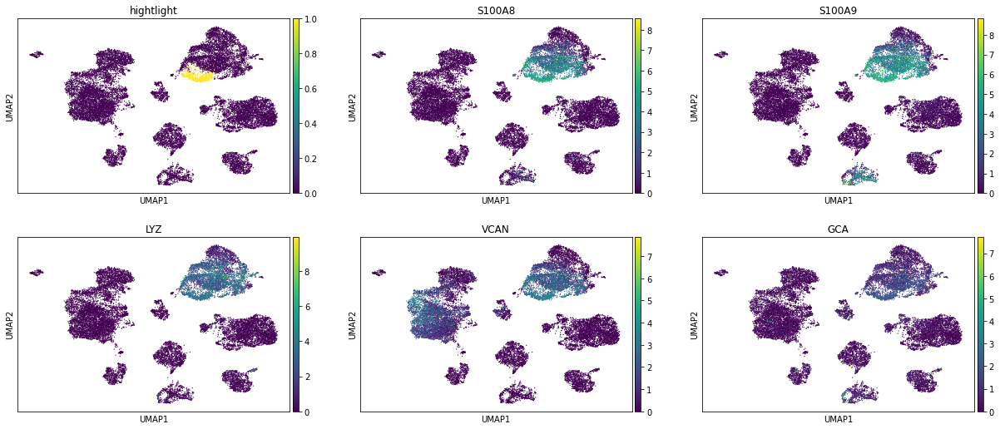

17


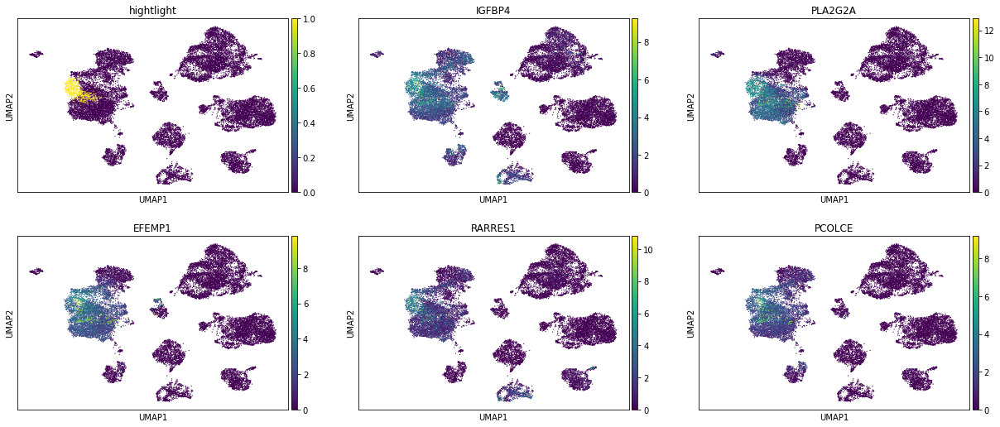

18


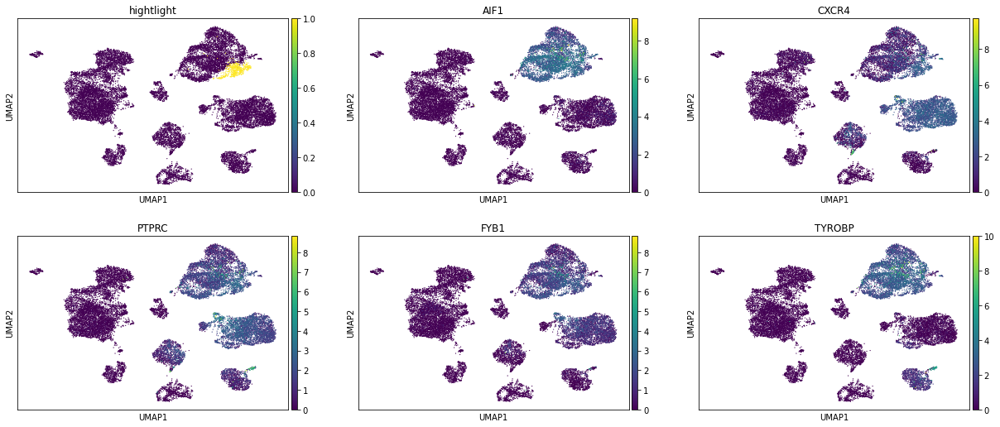

19


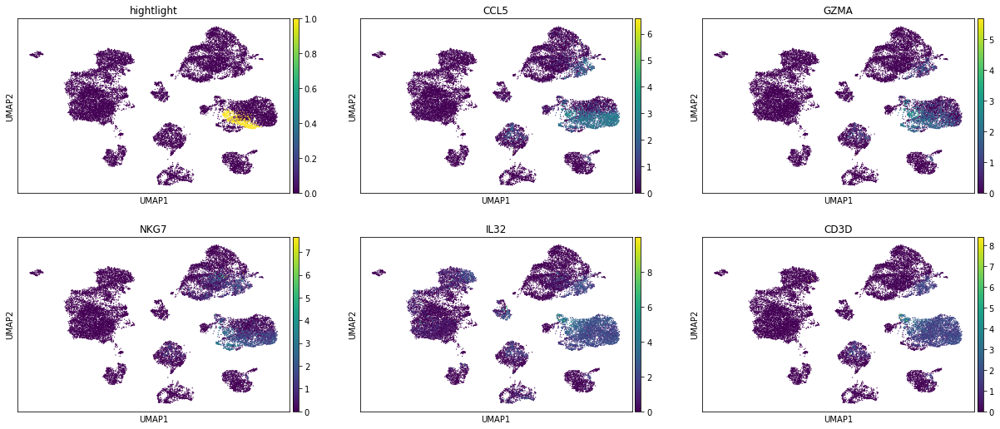

20


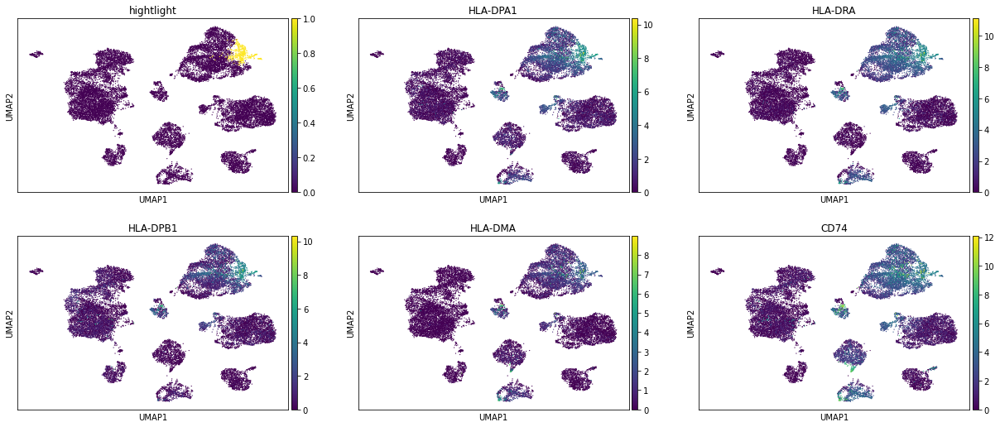

21


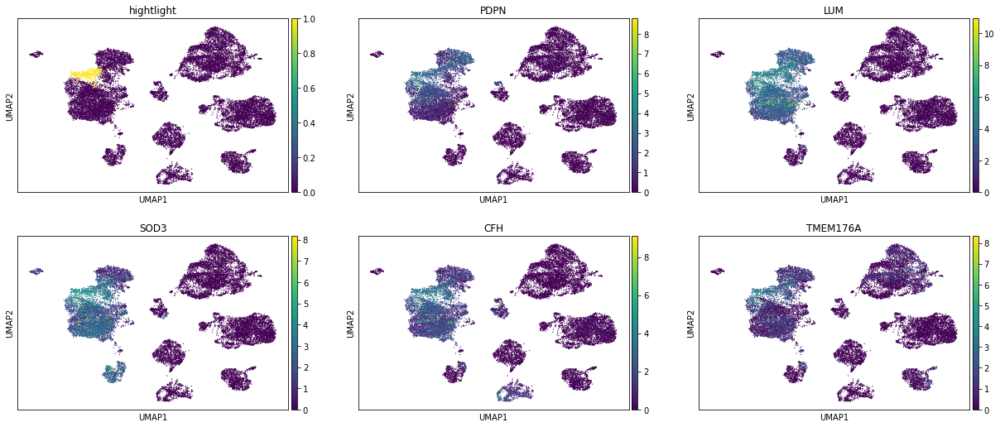

22


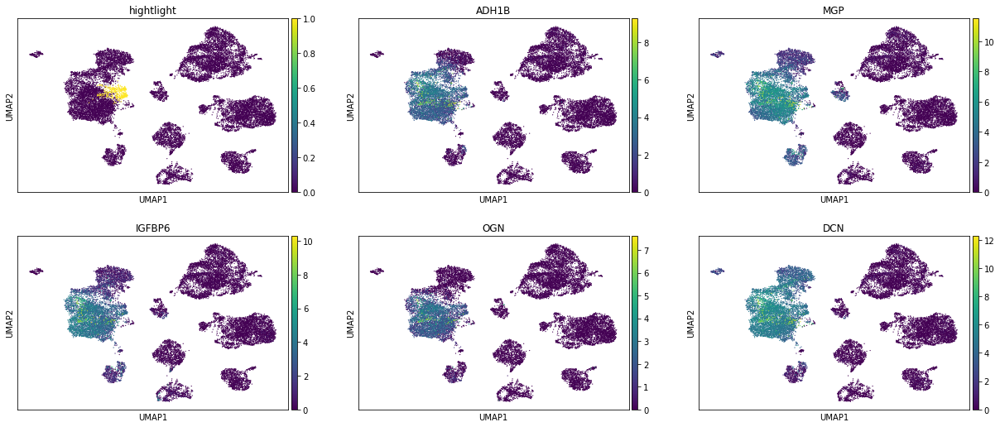

23


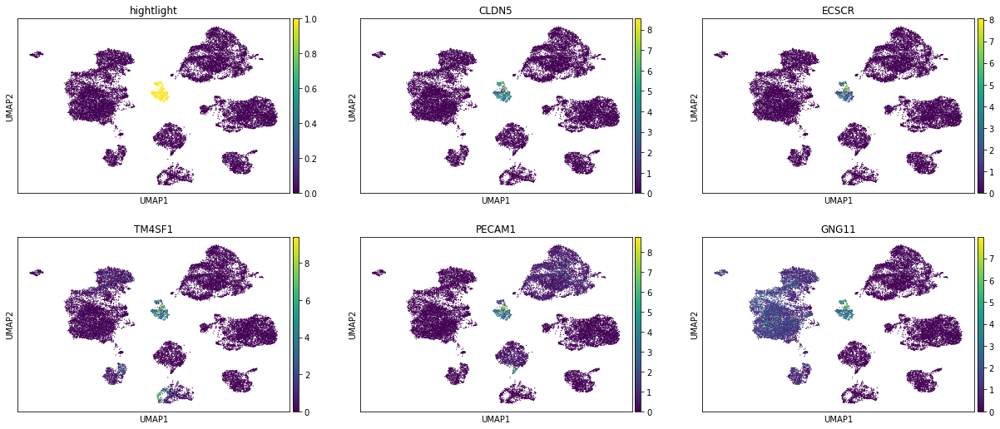

24


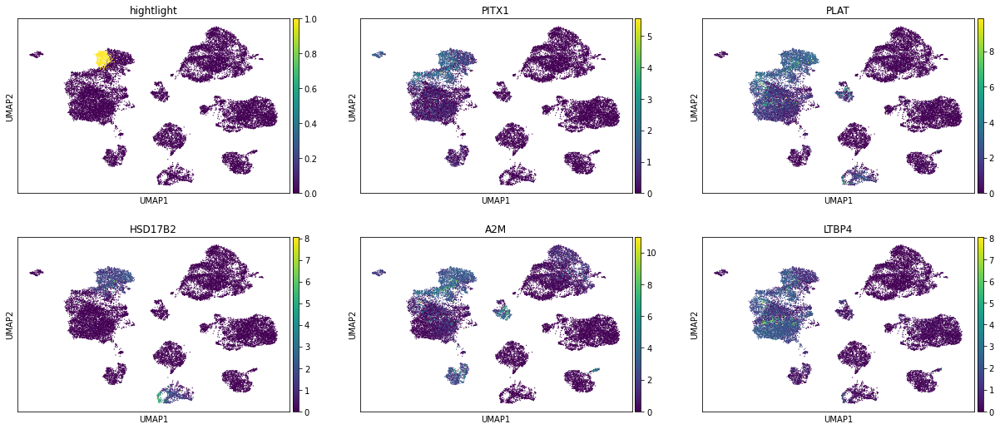

25


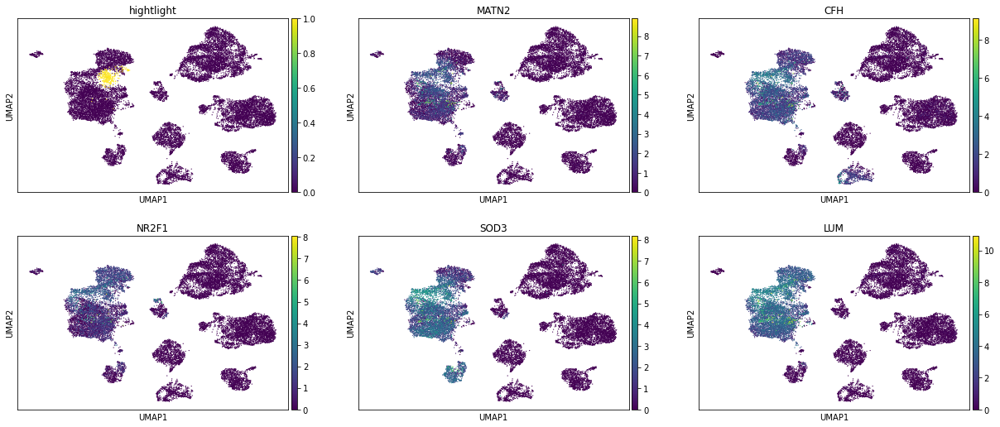

26


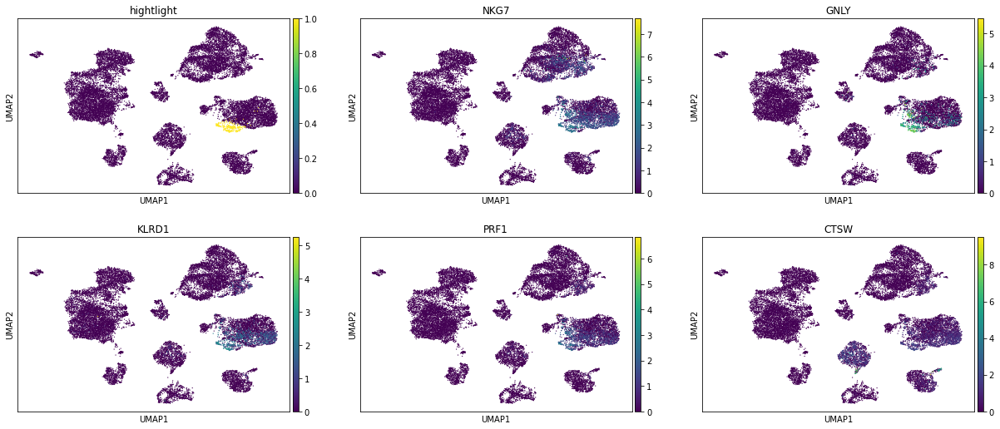

27


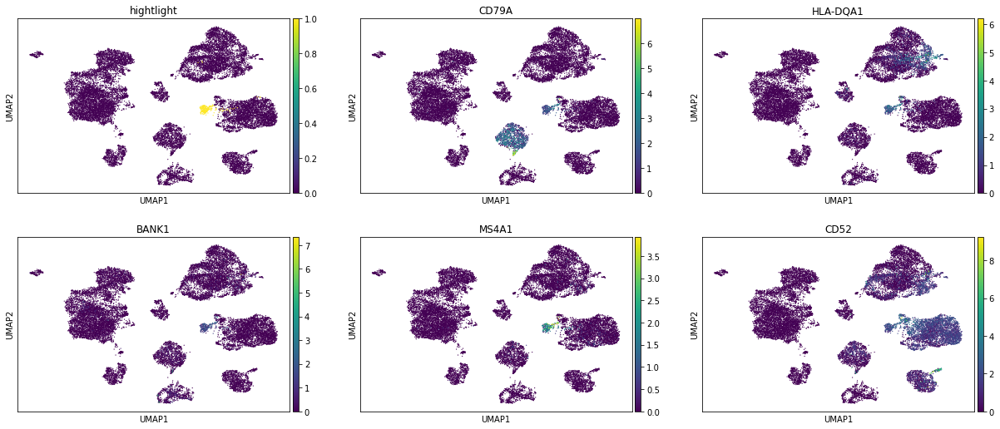

28


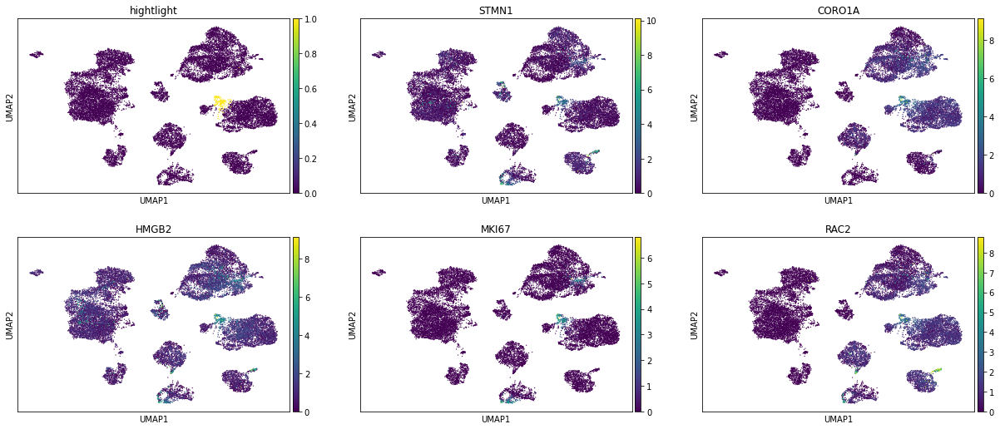

29


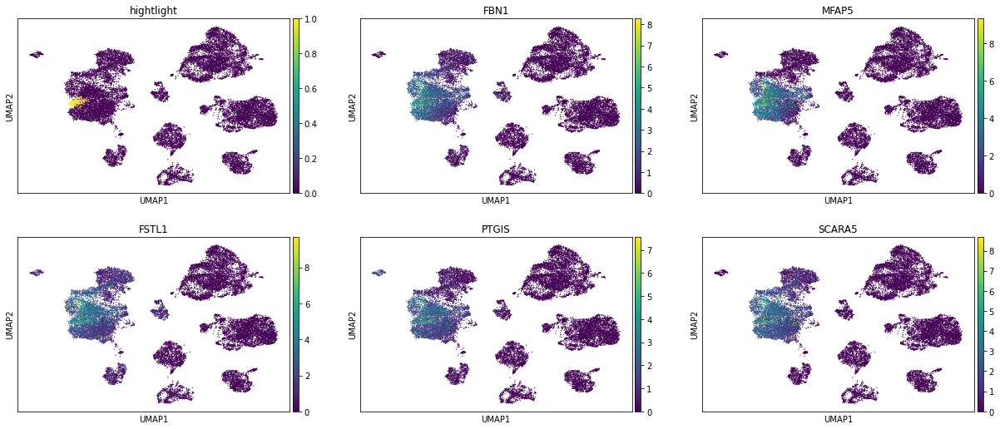

30


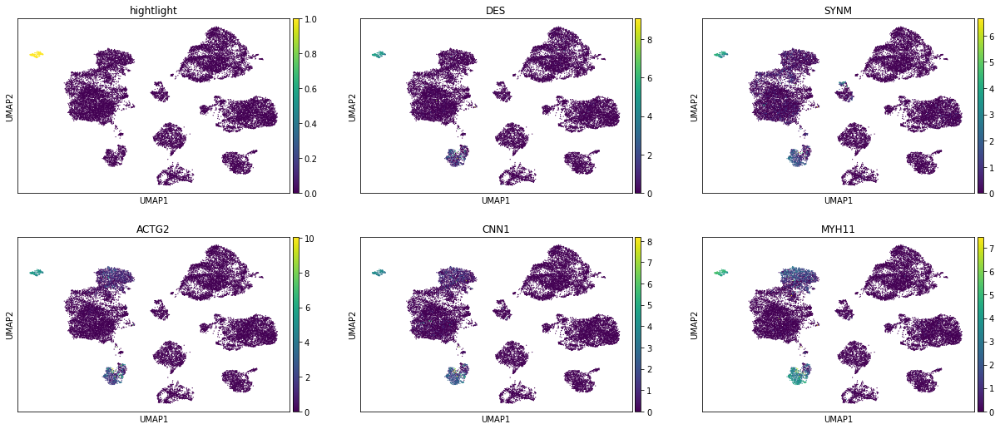

31


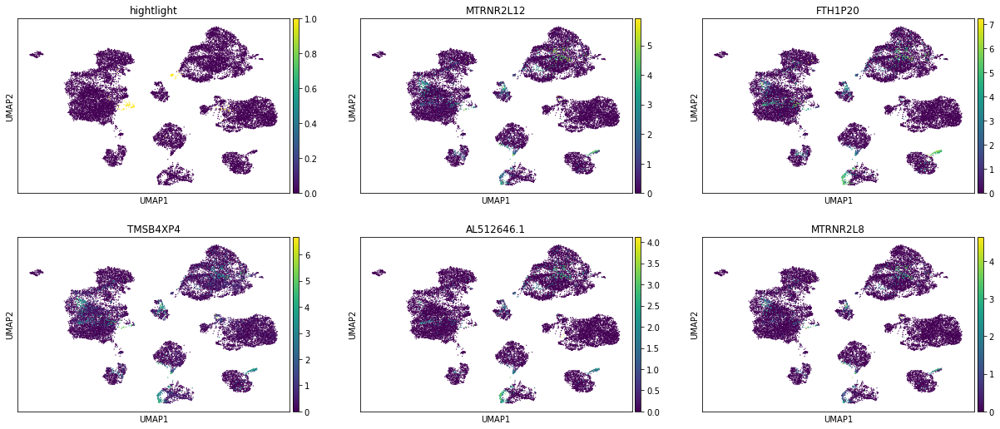

32


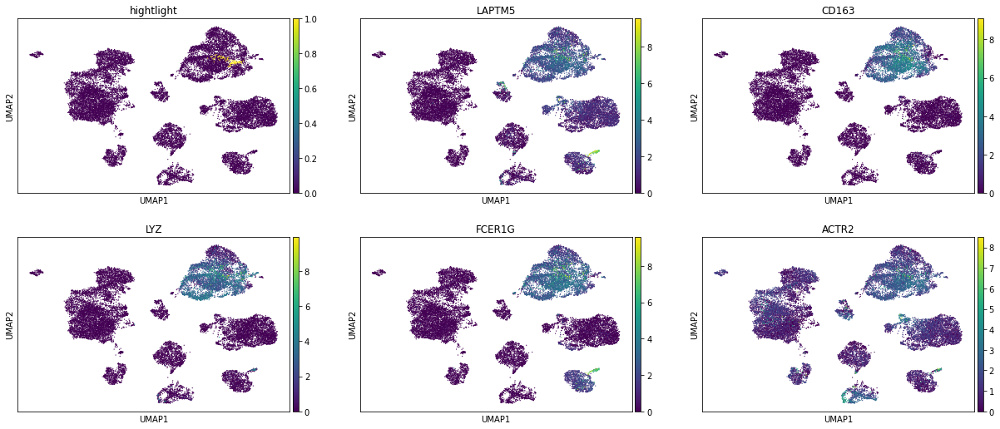

33


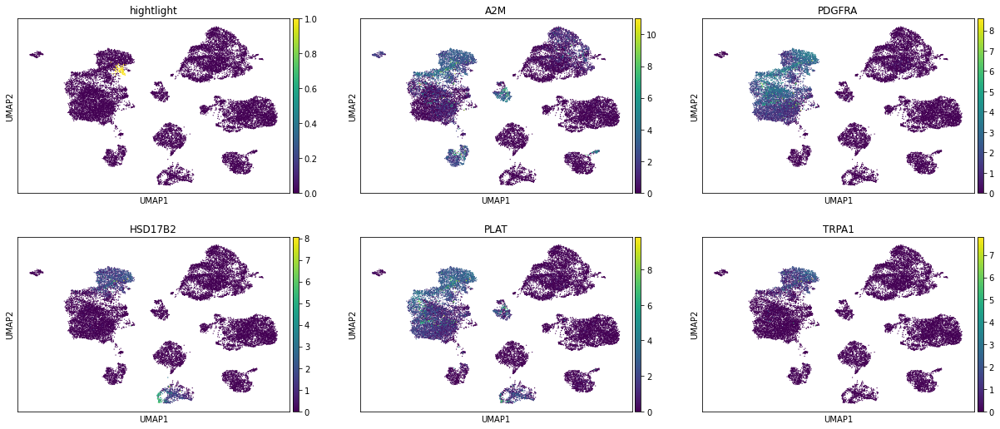

34


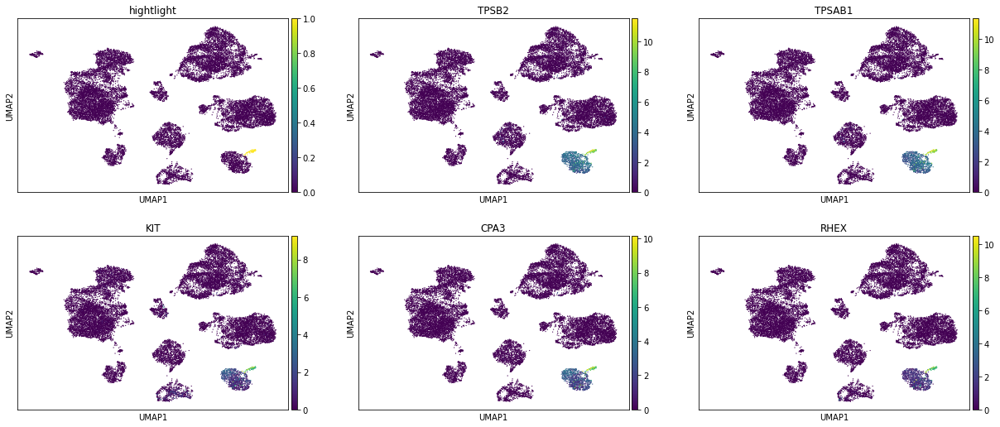

35


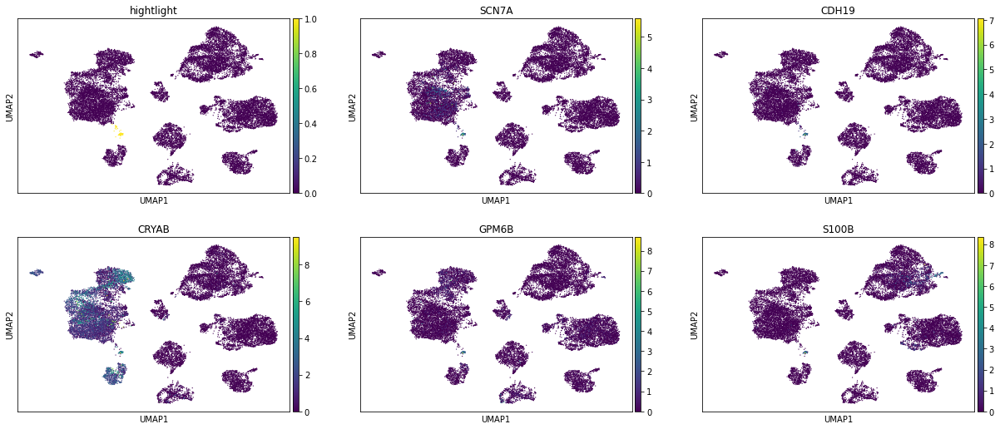

36


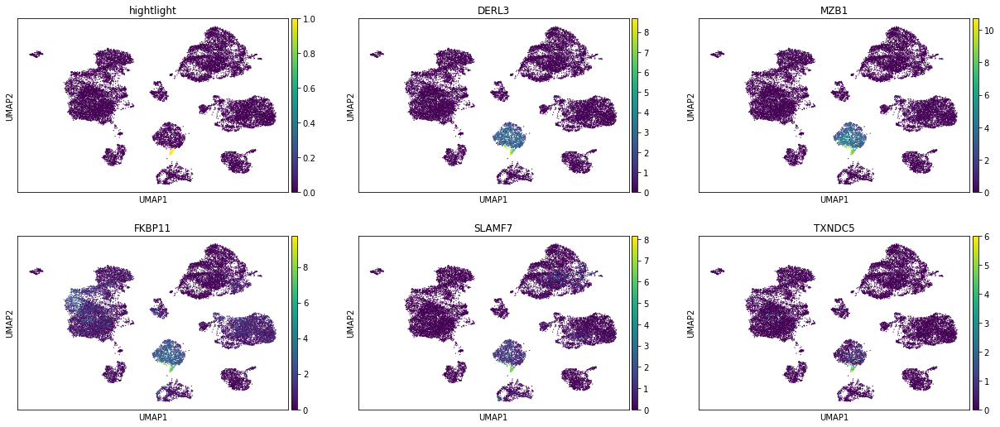

<IPython.core.display.Javascript object>

In [51]:
for x in DE.keys():
    print(x)
    topgenes = list(DE[x].T[:5].index)
    organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == x
    sc.pl.umap(
        organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

### The extended DE list can be queried by 

In [52]:
DE["0"].T

,wilcoxon_score,log fold change,adjusted pvalue
MZB1,54.887875,9.210375,0.0
JCHAIN,54.653519,13.455458,0.0
DERL3,53.610046,8.177074,0.0
SSR4,53.125519,4.410835,0.0
SEC11C,53.047897,5.036105,0.0
...,...,...,...
ANXA1,-44.025543,-4.717143,0.0
ACTB,-45.103020,-3.154377,0.0
S100A11,-45.614288,-4.032003,0.0
S100A6,-48.069656,-4.331966,0.0


<IPython.core.display.Javascript object>

# read in cell ontology 

In [53]:
import obonet

ont_dir = "/data/yosef2/users/chenling/TabulaSapiensData/ontology/"
obo = ont_dir + "cl.obo.txt"
f = open(obo, "r")
co = obonet.read_obo(f)
f.close()

celltype_dict = {}
for x in co.nodes:
    celltype_dict[co.nodes[x]['name']] = x



<IPython.core.display.Javascript object>

You can look up all T cell by typing celltype_dict['T'] and using tab complete  

In [55]:
celltype_dict["T cell"]

'CL:0000084'

<IPython.core.display.Javascript object>

You can also look at the names of all subsets of T cell that contains 'CD4' in their names

In [56]:
import networkx as nx


def PrintChildren(co, parent, pattern=""):
    all_children = [x for x in nx.ancestors(co, celltype_dict[parent])]
    return [co.nodes[x]["name"] for x in all_children if pattern in co.nodes[x]["name"]]


PrintChildren(co, "T cell", "CD4")

['CD4-positive, alpha-beta T cell',
 'central memory CD4-positive, alpha-beta T cell',
 'CD4-positive, CD25-positive, CCR4-positive, alpha-beta regulatory T cell',
 'CD4-negative CD8-negative gamma-delta intraepithelial T cell',
 'CD4-positive, CXCR3-negative, CCR6-negative, alpha-beta T cell',
 'activated CD4-positive, alpha-beta T cell, human',
 'CD4-positive helper T cell',
 'activated CD4-positive, CD25-positive, CCR4-positive, alpha-beta regulatory T cell, human',
 'CD4-positive type I NK T cell',
 'CD4-positive, alpha-beta cytotoxic T cell',
 'CD4-negative, CD8-negative type I NK T cell',
 'CD4-positive type I NK T cell secreting interleukin-4',
 'CD4-positive, alpha-beta thymocyte',
 'CD4-positive, alpha-beta intraepithelial T cell',
 'activated CD4-positive type I NK T cell',
 'CD4-positive, alpha-beta memory T cell',
 'naive thymus-derived CD4-positive, alpha-beta T cell',
 'CD4-positive, CD8-intermediate double-positive thymocyte',
 'mature CD4 single-positive thymocyte',
 'C

<IPython.core.display.Javascript object>

# manually create mapping between cluster and cell type (this is just an example), and the relevant marker genes that was used to generate this prediction

In [57]:
organ_adata.obs["annotation_oct2020"] = organ_adata.obs["leiden"].copy()
cluster_mapping = {"0": "T cell"}
cluster_markers = {"0": ["CXCR4", "CD3D", "IL7R", "IL32"]}

<IPython.core.display.Javascript object>

This cell will automatically replace the leiden cluster names with cell type annotations

In [58]:
for l in cluster_mapping.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, cluster_mapping[l], inplace=True)
    display(DE[l][cluster_markers[l]])

,CXCR4,CD3D,IL7R,IL32
wilcoxon_score,0.361388,-0.797100,-3.134777,-5.915549e+00
log fold change,-0.118660,-0.391454,-0.660420,-8.668015e-01
adjusted pvalue,1.000000,1.000000,0.014483,4.717162e-08


<IPython.core.display.Javascript object>

# Visualize the results of the manual annotation

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



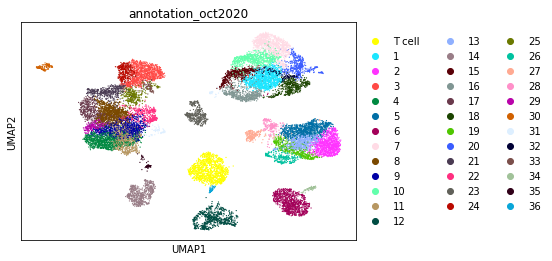

<IPython.core.display.Javascript object>

In [59]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# create celltype subcluster
This is just an example once the celltype annotations are done, how to subcluster cells in a celltype

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



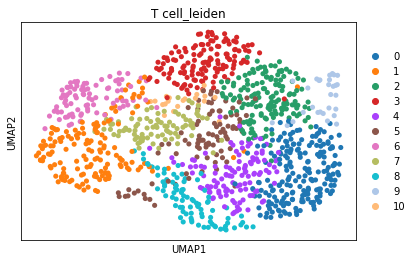

<IPython.core.display.Javascript object>

In [61]:
celltype = "T cell"
sub_organ_adata = organ_adata[organ_adata.obs["annotation_oct2020"] == celltype]
sc.pp.neighbors(sub_organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(
    sub_organ_adata,
)
sc.tl.leiden(sub_organ_adata, resolution=1, key_added="%s_leiden" % celltype)
sc.pl.umap(
    sub_organ_adata,
    color=["%s_leiden" % celltype],
    ncols=3,
)

In [62]:
sc.tl.rank_genes_groups(
    sub_organ_adata, groupby="%s_leiden" % celltype, method="wilcoxon"
)
sub_DE = FormatDE(sub_organ_adata.uns["rank_genes_groups"])

<IPython.core.display.Javascript object>

0


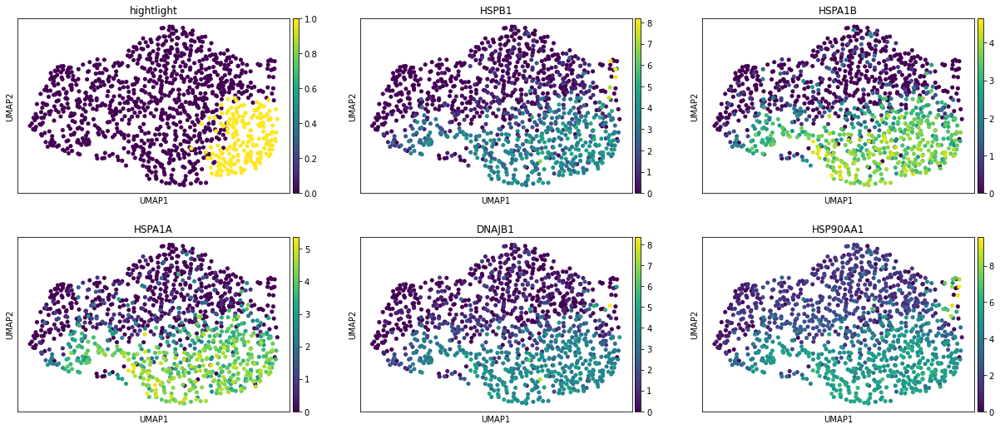

1


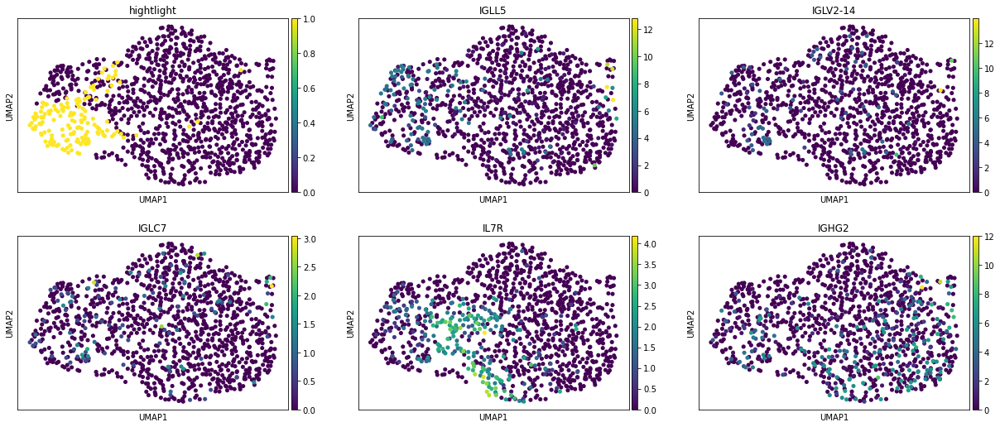

2


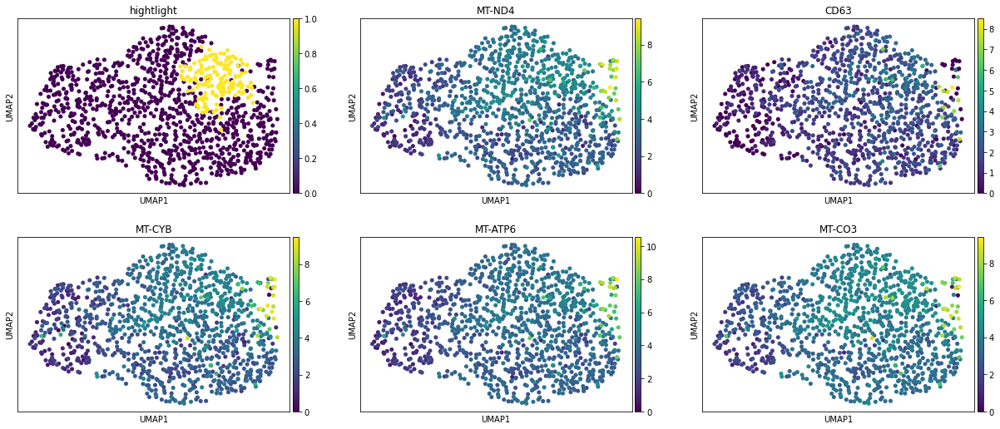

3


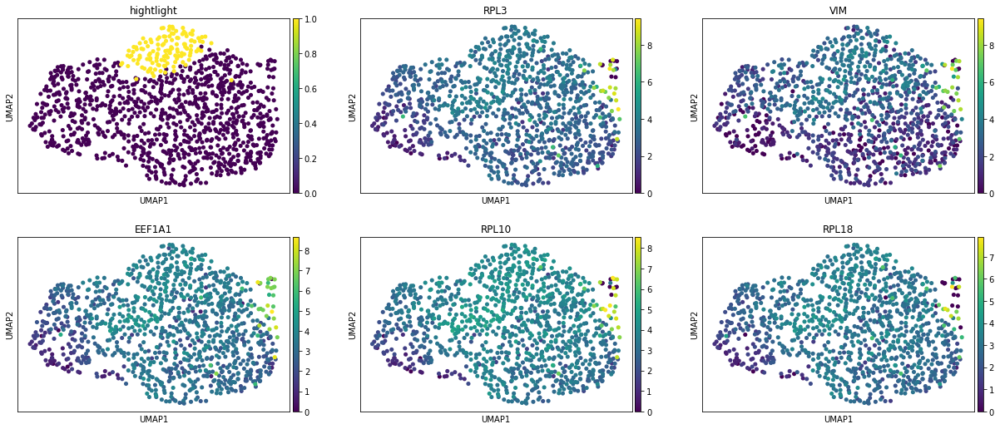

4


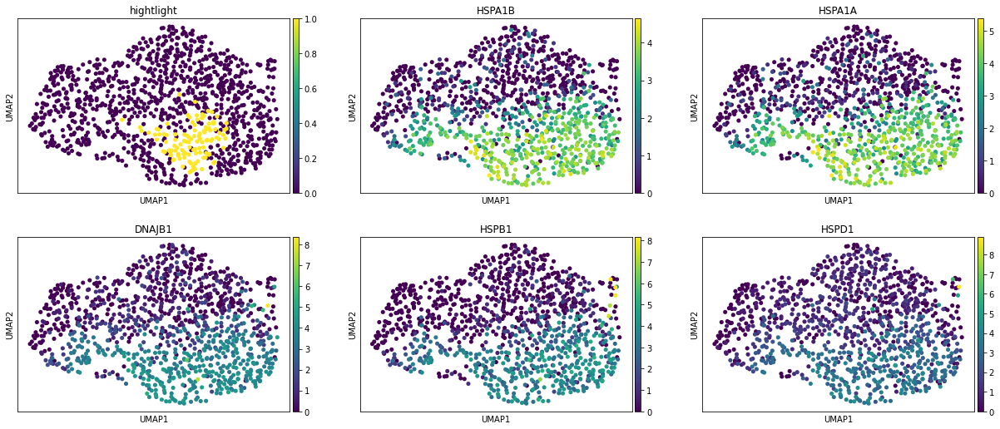

5


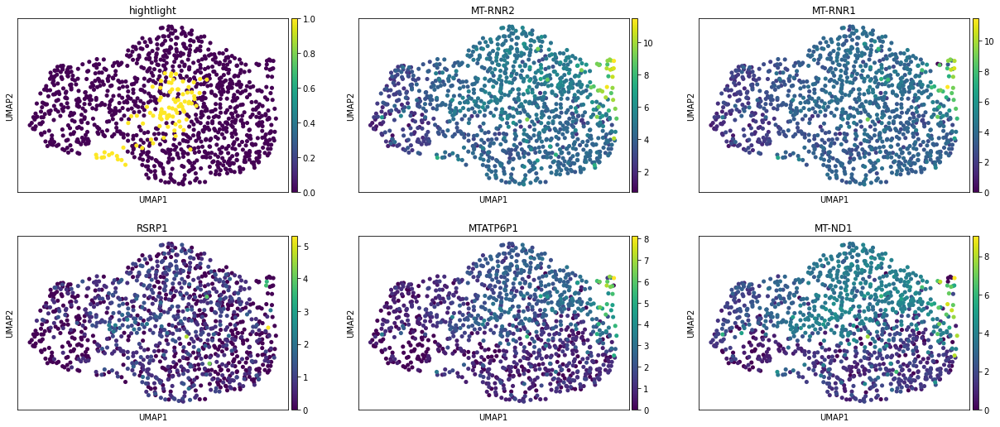

6


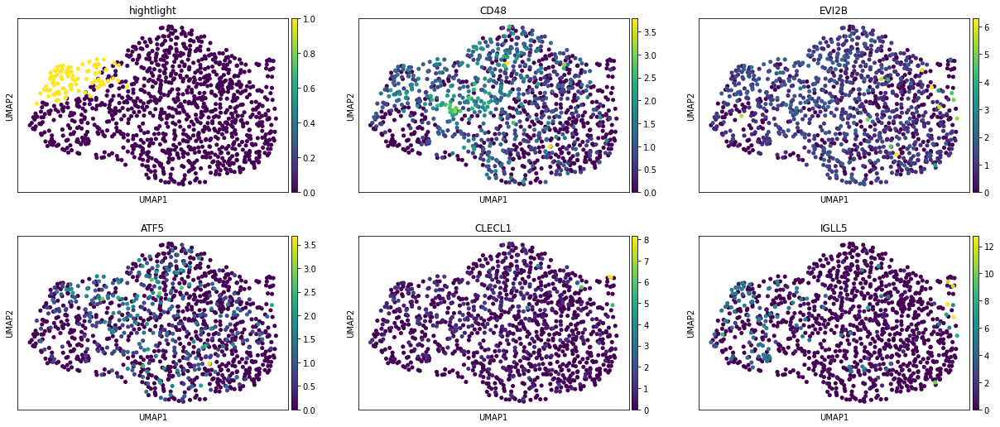

7


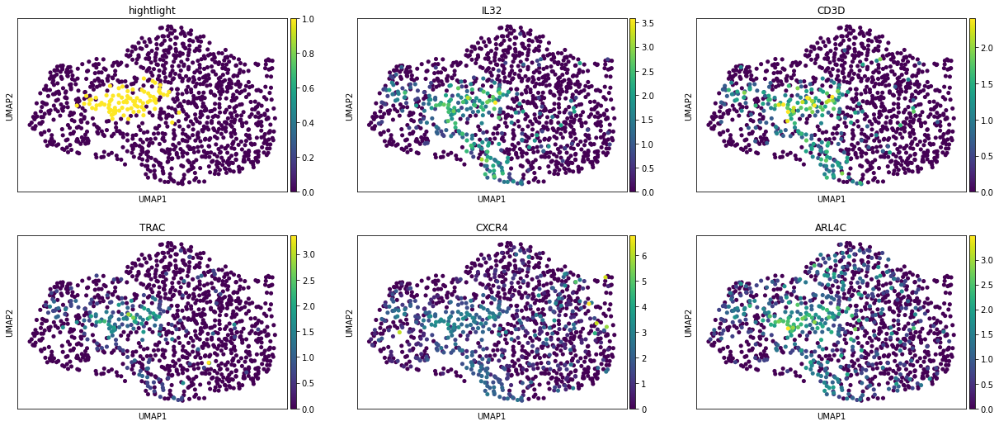

8


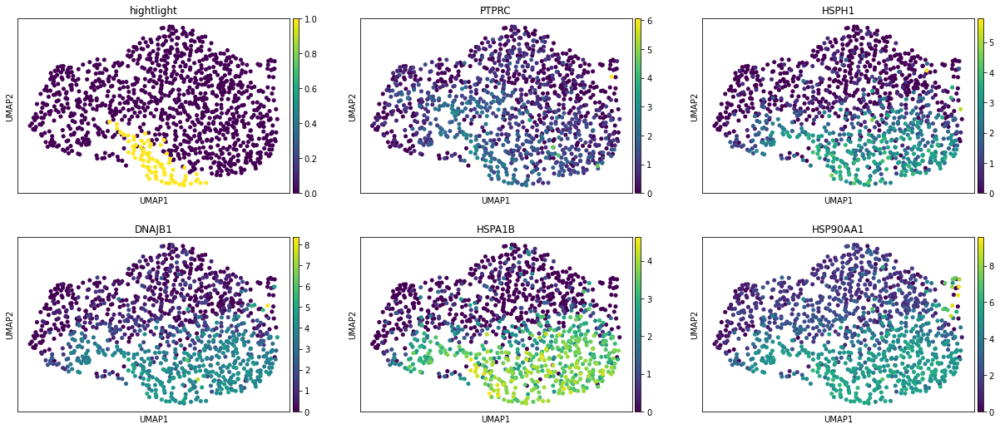

9


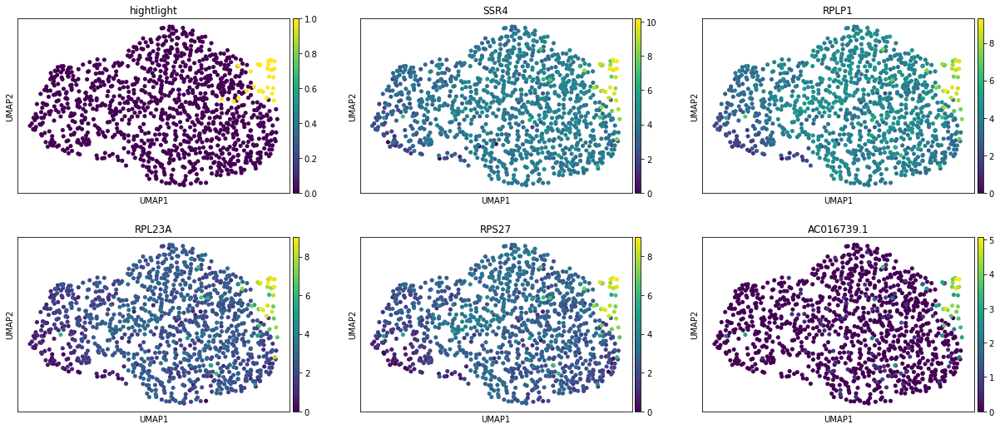

10


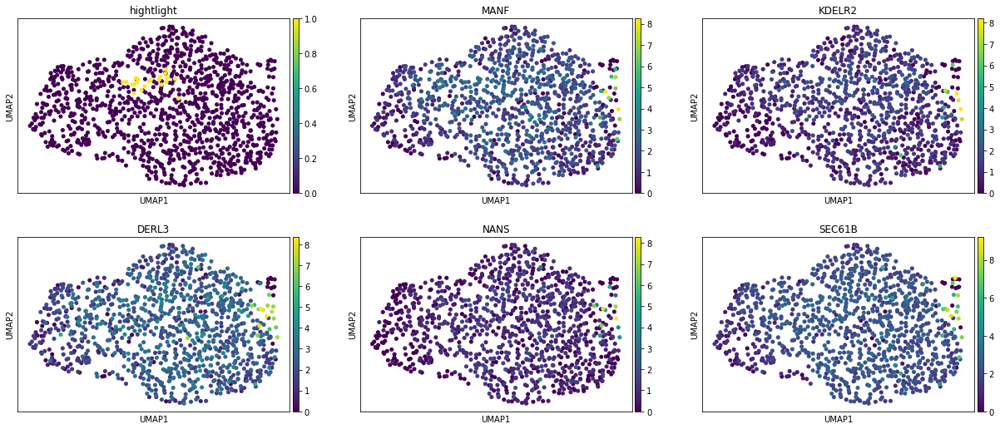

<IPython.core.display.Javascript object>

In [63]:
for x in sub_DE.keys():
    print(x)
    topgenes = list(sub_DE[x].T[:5].index)
    sub_organ_adata.obs["hightlight"] = sub_organ_adata.obs["%s_leiden" % celltype] == x
    sc.pl.umap(
        sub_organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

# manually create mapping between cell type and compartment (this is just an example)

In [64]:
organ_adata.obs["compartment_oct2020"] = organ_adata.obs["annotation_oct2020"].copy()
compartment_mapping = {"T cell": "Immune"}

<IPython.core.display.Javascript object>

This cell will automatically replace the leiden cluster names with cell type annotations

In [65]:
for c in compartment_mapping.keys():
    organ_adata.obs["compartment_oct2020"].replace(
        c, compartment_mapping[c], inplace=True
    )

<IPython.core.display.Javascript object>

# Visualize the results of the new compartment splitting

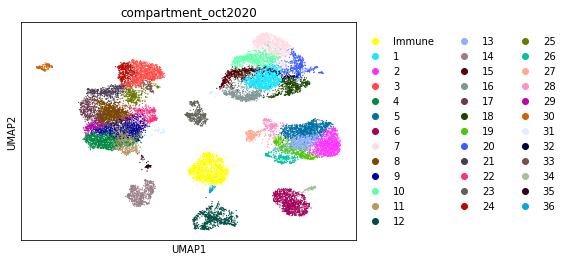

<IPython.core.display.Javascript object>

In [66]:
sc.pl.umap(
    organ_adata,
    color=["compartment_oct2020"],
    ncols=3,
)

# save data

In [67]:
organ_adata.write_h5ad(
    data_path + "decontX/organ_data/Pilot1_Pilot2.decontX.%s.h5ad" % organ
)

<IPython.core.display.Javascript object>